---
title: "Part3: Model Training and Bonus!"
author: ["Guntas Singh Saran", "Digvijay Singh Parihar"]
date: "2025-02-24"
image: "output.png"
format:
    html:
        code-fold: false
        code-tools: true
jupyter: python3
---

# [Final Split Dataset](https://www.kaggle.com/datasets/guntassinghsaran/satellite-aisg)

# [Weights & Biases Training Report](https://api.wandb.ai/links/digvijaysingh-parihar-iit-gandhinagar/y0w54hu8)

In [ ]:
!pip install ultralytics
!pip install -U ipywidgets
!pip install supervision
!pip install roboflow
!pip install shapely
!pip install -U wandb
!yolo settings wandb=True

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from roboflow import Roboflow
import supervision as sv
import pandas as pd
from ultralytics import YOLO
from PIL import Image
from shapely.geometry import box
from tqdm.notebook import tqdm
import seaborn as sns
import random
import glob

%matplotlib inline
%config InlineBackend.figure_format = 'retina'

In [4]:
dataset_location = "/kaggle/input/satellite-aisg/data"

In [ ]:
import wandb
wandb.login(key="<API-KEY>")

wandb: Using wandb-core as the SDK backend.  Please refer to https://wandb.me/wandb-core for more information.
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: digvijaysingh-parihar (digvijaysingh-parihar-iit-gandhinagar) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


True

In [6]:
wandb.init(project = "FinalUltralytics", name = "YOLO11v")

In [9]:
model = YOLO("yolo11m.pt")

In [ ]:
model.train(data = f"{dataset_location}/data.yaml", epochs = 50, imgsz = 640, batch = 16, workers = 4, device = 0, project = "FinalUltralytics", name = "YOLO11v")

Ultralytics 8.3.78 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolo11m.pt, data=/kaggle/input/satellite-aisg/data/data.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=0, workers=4, project=FinalUltralytics, name=YOLO11v, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True

train: Scanning /kaggle/input/satellite-aisg/data/train/labels... 1831 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1831/1831 [00:02<00:00, 720.84it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/satellite-aisg/data/train is not writeable, cache not saved.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


val: Scanning /kaggle/input/satellite-aisg/data/val/labels... 203 images, 0 backgrounds, 0 corrupt: 100%|██████████| 203/203 [00:00<00:00, 313.35it/s]

val: WARNING ⚠️ Cache directory /kaggle/input/satellite-aisg/data/val is not writeable, cache not saved.


Plotting labels to FinalUltralytics/YOLO11v/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001429, momentum=0.9) with parameter groups 106 weight(decay=0.0), 113 weight(decay=0.0005), 112 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to FinalUltralytics/YOLO11v
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      9.24G      1.457      1.458      1.279        164        640: 100%|██████████| 115/115 [01:09<00:00,  1.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:04<00:00,  1.72it/s]

                   all        203       2232      0.549      0.249      0.239       0.15



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.63G        1.3     0.9228      1.161        135        640: 100%|██████████| 115/115 [01:15<00:00,  1.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.84it/s]

                   all        203       2232      0.422      0.252     0.0812     0.0468



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      8.53G      1.249     0.8702      1.151        210        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        203       2232      0.924      0.271      0.376      0.234



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      8.79G      1.222     0.8092       1.13        167        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.95it/s]


                   all        203       2232      0.748      0.356      0.384      0.253

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      8.54G      1.157     0.7759      1.096        106        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.93it/s]


                   all        203       2232      0.739      0.456      0.547      0.381

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50       8.7G      1.104     0.7101       1.07        144        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.94it/s]


                   all        203       2232      0.661      0.425       0.42      0.279

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      8.56G      1.072     0.6872      1.061         74        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.94it/s]


                   all        203       2232      0.481      0.474      0.489      0.335

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50       8.7G      1.069     0.6731      1.055        164        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.96it/s]


                   all        203       2232      0.942      0.468      0.594      0.405

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      8.78G      1.038     0.6518      1.037        109        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]


                   all        203       2232        0.9      0.522      0.572      0.387

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      8.55G      1.004      0.613      1.022        126        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.737      0.606      0.626      0.413

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      8.53G     0.9817     0.5974      1.021        125        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.92it/s]

                   all        203       2232      0.563      0.581      0.603      0.401



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      8.86G     0.9693     0.5919       1.01        118        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232       0.86      0.645      0.733      0.523

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      8.52G     0.9407      0.572          1        310        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.749       0.68      0.714      0.532

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      8.62G     0.9273     0.5611     0.9932        142        640: 100%|██████████| 115/115 [01:14<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232      0.806      0.737      0.733      0.555

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.58G     0.9183     0.5411      0.987        101        640: 100%|██████████| 115/115 [01:13<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]


                   all        203       2232      0.926      0.721      0.761      0.558

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      8.71G     0.8901      0.532     0.9788        128        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232      0.903      0.719      0.783      0.598

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      8.54G     0.8703     0.5244      0.975        136        640: 100%|██████████| 115/115 [01:13<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.873      0.624      0.716      0.546

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      8.76G     0.8674     0.5111     0.9688        142        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232       0.87      0.722      0.819      0.614

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      8.54G     0.8221     0.4864     0.9492        121        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        203       2232      0.841       0.72      0.767      0.563



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      8.54G     0.8086     0.4847     0.9446        122        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.954      0.715       0.79      0.603

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      8.93G     0.7948     0.4774      0.943        137        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.905      0.743      0.774      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      8.51G     0.7927      0.474      0.947        152        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232      0.913      0.766       0.78      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      8.82G     0.7714     0.4669     0.9363        230        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232       0.92      0.705      0.783      0.628

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      8.55G       0.77     0.4663     0.9403        168        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.96it/s]

                   all        203       2232       0.95      0.734        0.8      0.647



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      8.52G     0.7492     0.4512     0.9302        174        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        203       2232       0.97      0.769      0.829      0.649



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      8.82G     0.7376     0.4444      0.925        230        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.96it/s]

                   all        203       2232      0.961      0.743      0.784      0.643



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      8.79G     0.7184     0.4389     0.9207        175        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]


                   all        203       2232      0.958       0.74      0.818      0.648

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.88G     0.7015     0.4278     0.9164        137        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.98it/s]

                   all        203       2232      0.981      0.805      0.861      0.689



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      8.64G     0.6932     0.4209     0.9117        115        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        203       2232      0.963      0.793      0.839      0.682



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      8.73G      0.671     0.4141     0.9089         68        640: 100%|██████████| 115/115 [01:13<00:00,  1.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]

                   all        203       2232      0.963      0.747       0.87      0.708



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      8.54G     0.6711     0.4114     0.9024        166        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]

                   all        203       2232      0.949      0.848      0.909      0.726



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.84G     0.6485     0.3991     0.8974        103        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.97it/s]

                   all        203       2232      0.988      0.801      0.847      0.703



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      8.67G     0.6343     0.3919     0.8965         86        640: 100%|██████████| 115/115 [01:13<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]

                   all        203       2232      0.982      0.822      0.876      0.742



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.59G     0.6484     0.3989     0.8985        121        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]

                   all        203       2232      0.948      0.755      0.829       0.71



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50       8.8G     0.6263     0.3911      0.892        127        640: 100%|██████████| 115/115 [01:13<00:00,  1.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:03<00:00,  1.99it/s]


                   all        203       2232      0.985      0.804      0.873      0.726

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      8.75G     0.6276     0.3914     0.8976        257        640:  36%|███▌      | 41/115 [00:26<00:47,  1.55it/s]

# Getting to know SuperVision
#### [poor documention, refer code](https://github.com/roboflow/supervision/blob/develop/supervision/annotators/core.py)

In [ ]:
results = model("/kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_4766_y0_12968_dxdy_416.tif")

In [ ]:
len(results), results[0]

In [ ]:
results[0].boxes

In [ ]:
result = results[0]
boxes = result.boxes.xyxy.cpu().numpy()
scores = result.boxes.conf.cpu().numpy()
labels = result.boxes.cls.cpu().numpy().astype(int)
img = result.orig_img
sv_det = sv.Detections(
                xyxy=boxes,
                confidence=scores,
                class_id=labels)
class_ids = {0: 'high', 1: 'moderate', 2: 'low'}
sv_det.data["class_name"] = np.array([f"{class_ids[sv_det.class_id[i]]}: {sv_det.confidence[i]:.2f}" for i in range(len(sv_det.class_id))])
sv_det

In [ ]:
bounding_box_annotator = sv.BoxAnnotator()
annotated_img = bounding_box_annotator.annotate(
    scene=img.copy(),
    detections=sv_det
)
plt.imshow(annotated_img)

In [ ]:
label_annotator = sv.LabelAnnotator(text_scale=0.3, smart_position = True)
label_annotated_img = label_annotator.annotate(annotated_img, sv_det)
plt.imshow(label_annotated_img)

# Loading Saved Model (A Demo)

In [ ]:
# Paste this from the WANDB Artifact Segment
run = wandb.init()
artifact = run.use_artifact('<artificat-location>', type='model')
artifact_dir = artifact.download()

wandb:   1 of 1 files downloaded.  


In [7]:
model = YOLO(f"{artifact_dir}/best.pt")

# Predict solar panels using the trained model

In [8]:
def give_image(fileIm, model, fileLb = None):
    
    im = Image.open(fileIm)
    im = np.array(im)
    
    results = model(fileIm)
    
    data_pred = []
    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        scores = result.boxes.conf.cpu().numpy()
        labels = result.boxes.cls.cpu().numpy().astype(int)
        
        sv_det = sv.Detections(
                        xyxy=boxes,
                        confidence=scores,
                        class_id=labels)
        class_ids = {0: 'high', 1: 'moderate', 2: 'low'}
        sv_det.data["class_name"] = np.array([f"{class_ids[sv_det.class_id[i]]}: {sv_det.confidence[i]:.2f}" for i in range(len(sv_det.class_id))])

        bounding_box_annotator = sv.BoxAnnotator()
        annotated_img = bounding_box_annotator.annotate(
            scene=im.copy(),
            detections=sv_det
        )

        label_annotator = sv.LabelAnnotator(text_scale=0.3, text_padding = 5, smart_position = True)
        annotated_img = label_annotator.annotate(annotated_img, sv_det)
        
        for (box, conf, class_id) in zip(boxes, scores, labels):
            x1, y1, x2, y2 = map(int, box)
            data_pred.append((class_id, (x1, y1), (x2, y2), conf))
            
    data_pred = sorted(data_pred)

    if fileLb:
        with open(fileLb, 'r') as f:
            lines = f.readlines()
        data_org = []
        for line in lines:
            line = line.strip().split()
            class_id, x_center, y_center, width, height = map(float, line)
            x_center, y_center = int(x_center * im.shape[1]), int(y_center * im.shape[0])
            width, height = int(width * im.shape[1]), int(height * im.shape[0])
            
            x1, y1 = x_center - width // 2, y_center - height // 2
            x2, y2 = x_center + width // 2, y_center + height // 2
    
            if class_id == 0:
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (0, 255, 0), 2)
            elif class_id == 1:
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (0, 0, 255), 2)
            elif class_id == 2:
                cv2.rectangle(annotated_img, (x1, y1), (x2, y2), (255, 0, 0), 2)
            
            data_org.append((class_id, (x1, y1), (x2, y2)))
    
        data_org = sorted(data_org)
        print("=================Original=================")
        for i, data in enumerate(data_org):
            print(i, ": ", data)
            
    print("\n=================Prediction=================")
    for i, data in enumerate(data_pred):
        print(i, ": ", data)
        
    plt.figure(figsize=(6, 6))
    plt.imshow(annotated_img)
    plt.axis('off')
    plt.show()


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_10185_y0_9767_dxdy_416.tif: 640x640 43 highs, 36.9ms
Speed: 3.1ms preprocess, 36.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (0, 312), (18, 374))
1 :  (0.0, (0, 391), (58, 415))
2 :  (0.0, (13, 362), (101, 416))
3 :  (0.0, (27, 280), (153, 416))
4 :  (0.0, (29, 355), (119, 415))
5 :  (0.0, (58, 263), (198, 415))
6 :  (0.0, (121, 226), (173, 282))
7 :  (0.0, (157, 200), (211, 256))
8 :  (0.0, (176, 269), (210, 309))
9 :  (0.0, (188, 264), (218, 302))
10 :  (0.0, (199, 177), (251, 233))
11 :  (0.0, (203, 311), (243, 365))
12 :  (0.0, (214, 302), (258, 358))
13 :  (0.0, (218, 246), (248, 284))
14 :  (0.0, (227, 237), (259, 277))
15 :  (0.0, (234, 361), (266, 397))
16 :  (0.0, (237, 287), (283, 341))
17 :  (0.0, (238, 154), (282, 208))
18 :  (0.0, (247, 351), (279, 389))
19 :  (0.0, (252, 278), (296, 330))
20 :  (0.0, (257, 221), (

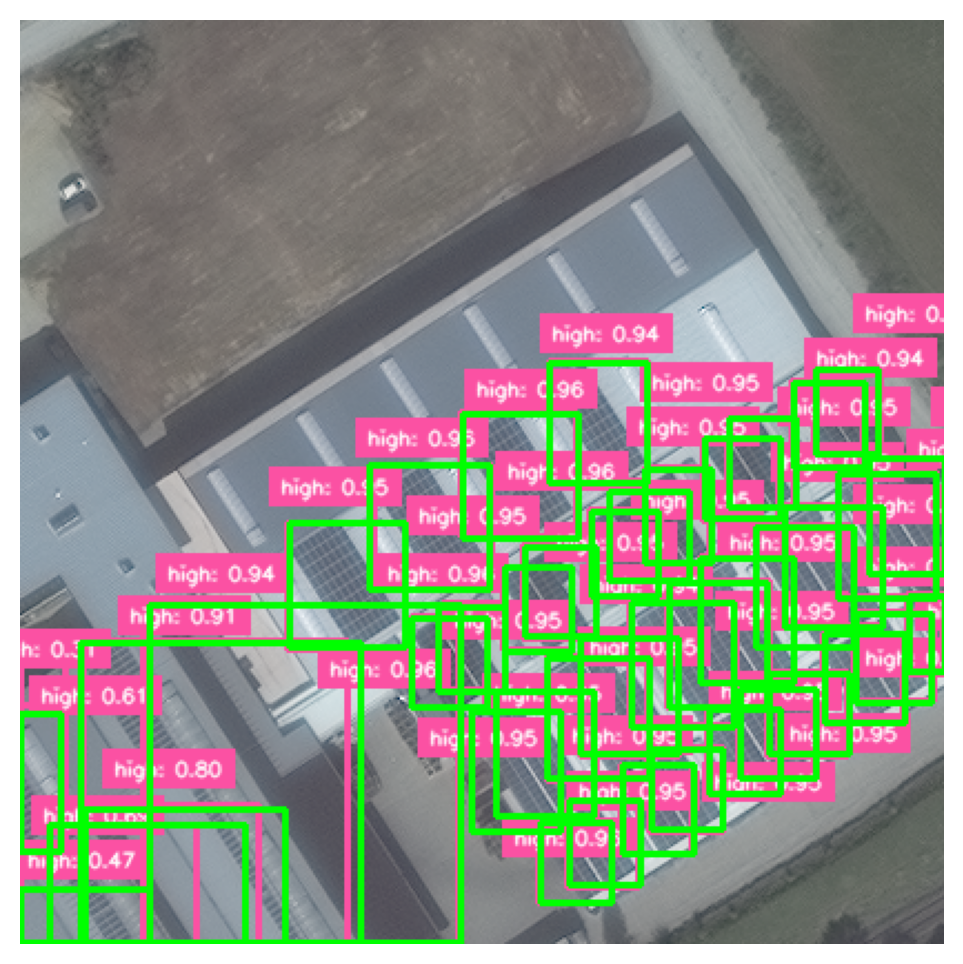


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_3507_y0_10308_dxdy_416.tif: 640x640 3 highs, 36.8ms
Speed: 2.2ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (168, 58), (210, 92))
1 :  (0.0, (199, 154), (301, 228))
2 :  (0.0, (218, 144), (304, 198))

=================Prediction=================
0 :  (0, (167, 57), (210, 92), 0.91490316)
1 :  (0, (198, 153), (301, 228), 0.95831615)
2 :  (0, (219, 143), (304, 198), 0.93578416)


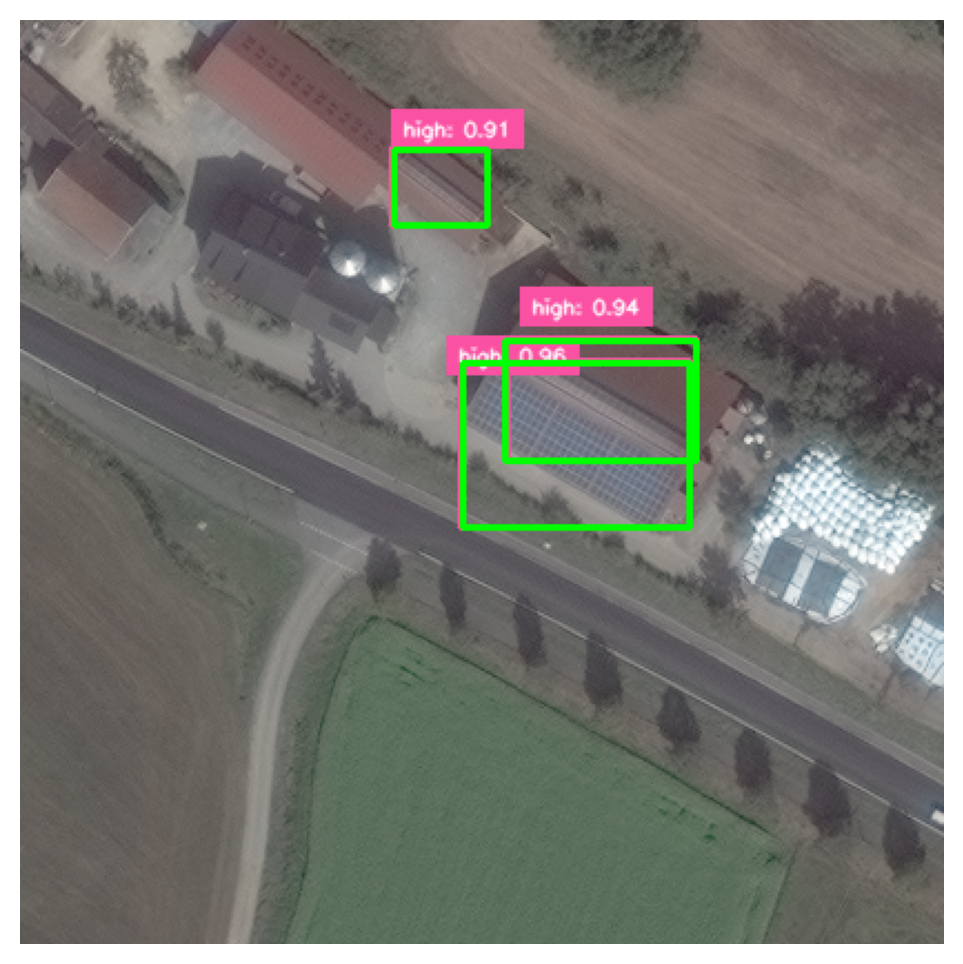


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_2__x0_15536_y0_14453_dxdy_416.tif: 640x640 3 highs, 36.8ms
Speed: 2.2ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (187, 98), (197, 104))
1 :  (0.0, (204, 164), (262, 190))
2 :  (0.0, (404, 400), (416, 416))

=================Prediction=================
0 :  (0, (186, 95), (198, 104), 0.38698897)
1 :  (0, (204, 163), (262, 191), 0.9209438)
2 :  (0, (404, 399), (416, 416), 0.71941924)


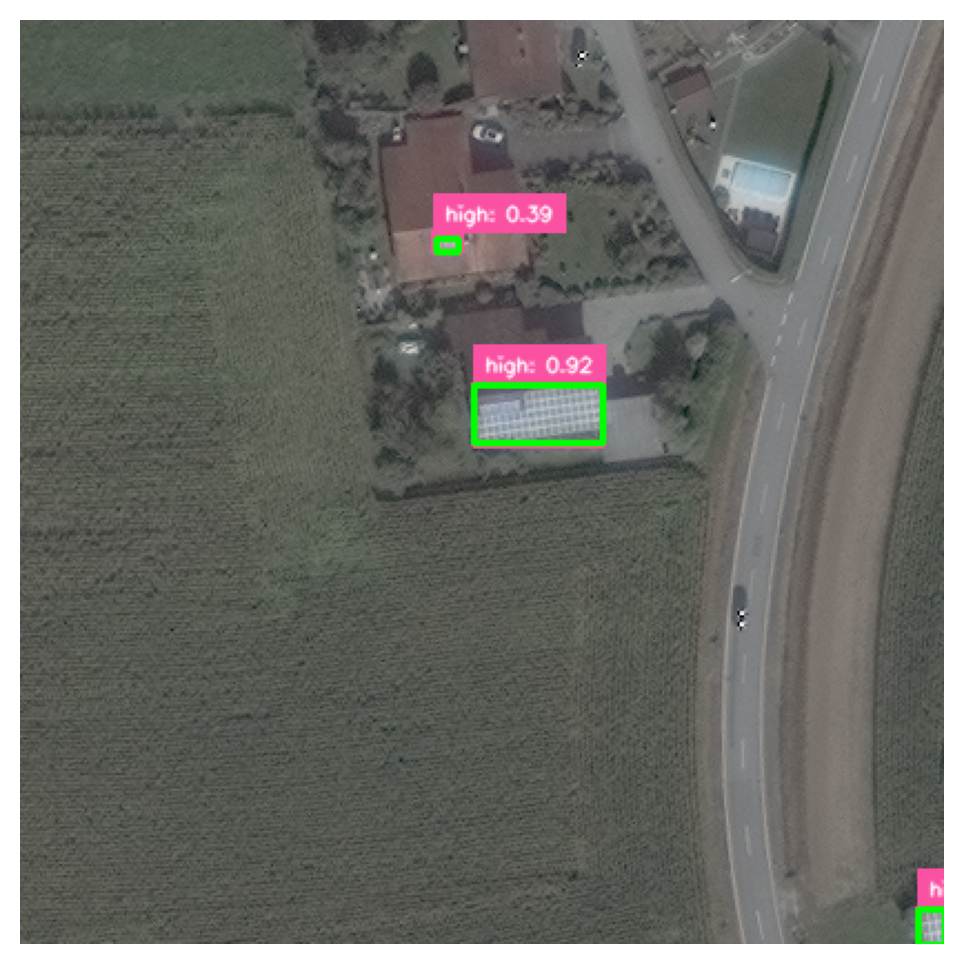


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_1057_y0_7326_dxdy_416.tif: 640x640 11 highs, 36.8ms
Speed: 2.3ms preprocess, 36.8ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (10, 300), (28, 318))
1 :  (0.0, (30, 114), (70, 158))
2 :  (0.0, (149, 94), (161, 114))
3 :  (0.0, (155, 286), (173, 300))
4 :  (0.0, (164, 67), (180, 89))
5 :  (0.0, (197, 394), (211, 408))
6 :  (0.0, (216, 411), (232, 415))
7 :  (0.0, (229, 157), (257, 185))
8 :  (0.0, (366, 346), (382, 370))
9 :  (0.0, (366, 370), (398, 416))
10 :  (0.0, (397, 280), (415, 306))

=================Prediction=================
0 :  (0, (10, 300), (28, 318), 0.90315515)
1 :  (0, (30, 113), (69, 157), 0.93828917)
2 :  (0, (148, 93), (161, 114), 0.8814513)
3 :  (0, (155, 285), (172, 301), 0.88774616)
4 :  (0, (163, 66), (181, 89), 0.9137605)
5 :  (0, (196, 394), (212, 409), 0.89832366)
6 :  (0, (215, 411), (228, 415), 0.52364

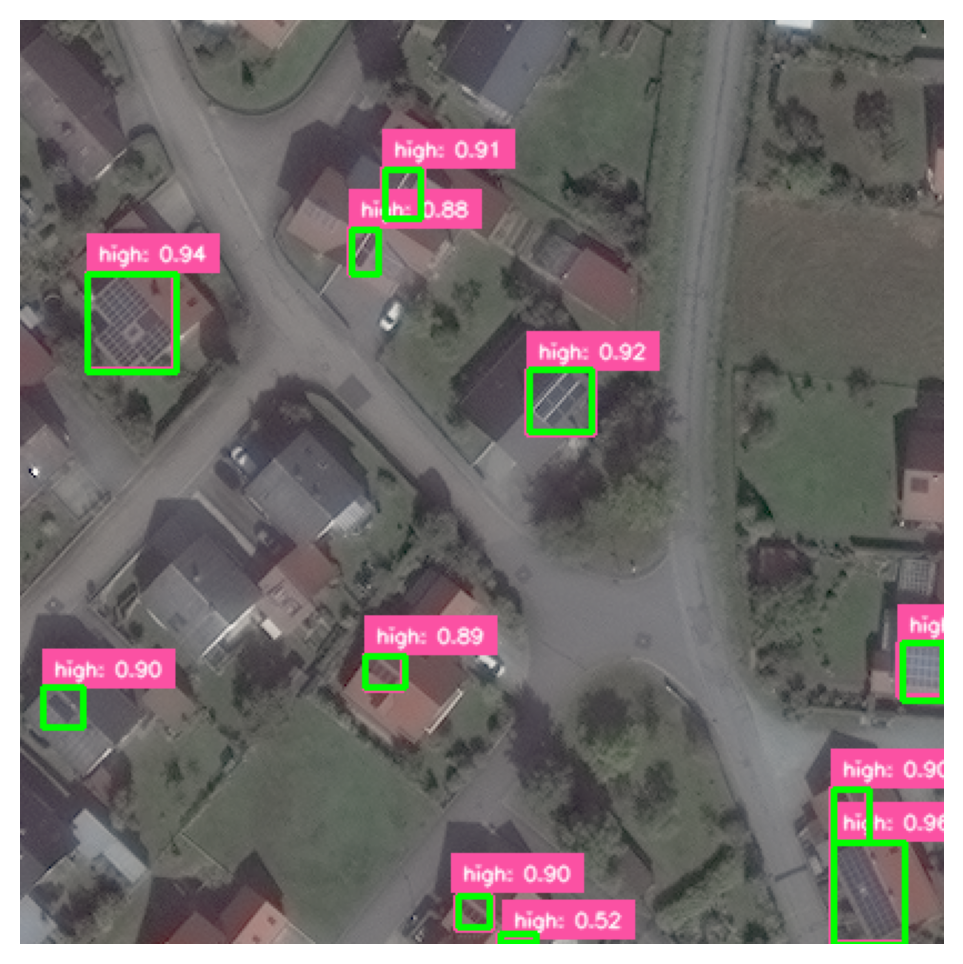

In [15]:
test_images = glob.glob(f"{dataset_location}/test/images/*.tif")
random_samples = random.sample(test_images, 4)

for img_path in random_samples:
    label_path = img_path.replace("images", "labels").replace(".tif", ".txt")
    give_image(img_path, model, label_path)


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_368_y0_7395_dxdy_416.tif: 640x640 7 highs, 1 low, 36.9ms
Speed: 2.4ms preprocess, 36.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (59, 207), (113, 251))
1 :  (0.0, (176, 204), (208, 226))
2 :  (0.0, (203, 234), (229, 260))
3 :  (0.0, (340, 351), (388, 399))
4 :  (0.0, (357, 97), (375, 115))
5 :  (0.0, (367, 111), (387, 129))
6 :  (0.0, (391, 89), (411, 109))
7 :  (2.0, (170, 180), (204, 210))

=================Prediction=================
0 :  (0, (59, 206), (113, 251), 0.9421165)
1 :  (0, (176, 203), (207, 227), 0.90640813)
2 :  (0, (202, 234), (230, 261), 0.93654466)
3 :  (0, (340, 350), (388, 398), 0.9431328)
4 :  (0, (357, 96), (374, 115), 0.901244)
5 :  (0, (367, 110), (386, 130), 0.91215146)
6 :  (0, (390, 89), (411, 108), 0.91191894)
7 :  (2, (169, 179), (204, 211), 0.9473606)


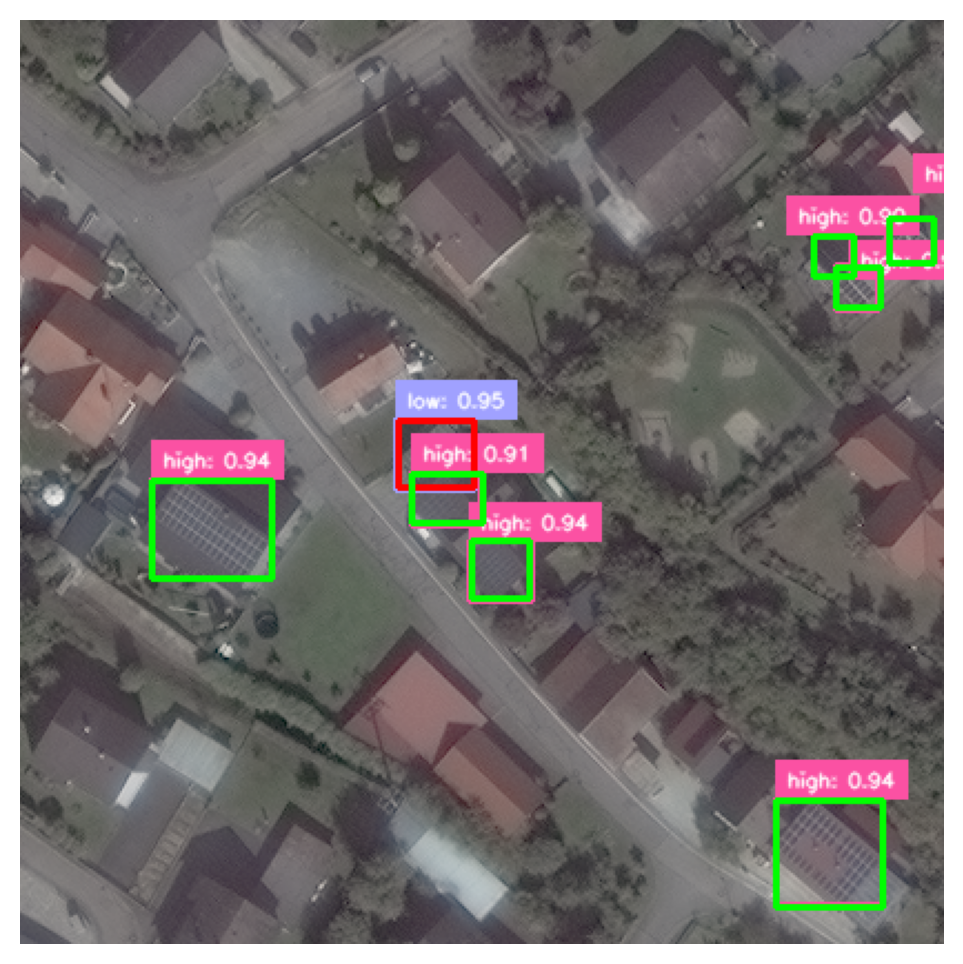


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_7604_y0_9799_dxdy_416.tif: 640x640 7 highs, 1 low, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (48, 0), (66, 10))
1 :  (0.0, (122, 210), (140, 220))
2 :  (0.0, (200, 114), (250, 168))
3 :  (0.0, (254, 232), (282, 266))
4 :  (0.0, (280, 214), (320, 242))
5 :  (0.0, (336, 172), (354, 196))
6 :  (0.0, (337, 205), (399, 247))
7 :  (2.0, (0, 214), (34, 242))

=================Prediction=================
0 :  (0, (47, 0), (64, 9), 0.5840571)
1 :  (0, (121, 210), (140, 220), 0.8610268)
2 :  (0, (199, 113), (250, 168), 0.95477086)
3 :  (0, (254, 231), (283, 266), 0.9301954)
4 :  (0, (281, 213), (321, 241), 0.92727745)
5 :  (0, (335, 171), (354, 196), 0.9200325)
6 :  (0, (337, 204), (399, 247), 0.93252647)
7 :  (2, (0, 213), (35, 241), 0.958617)


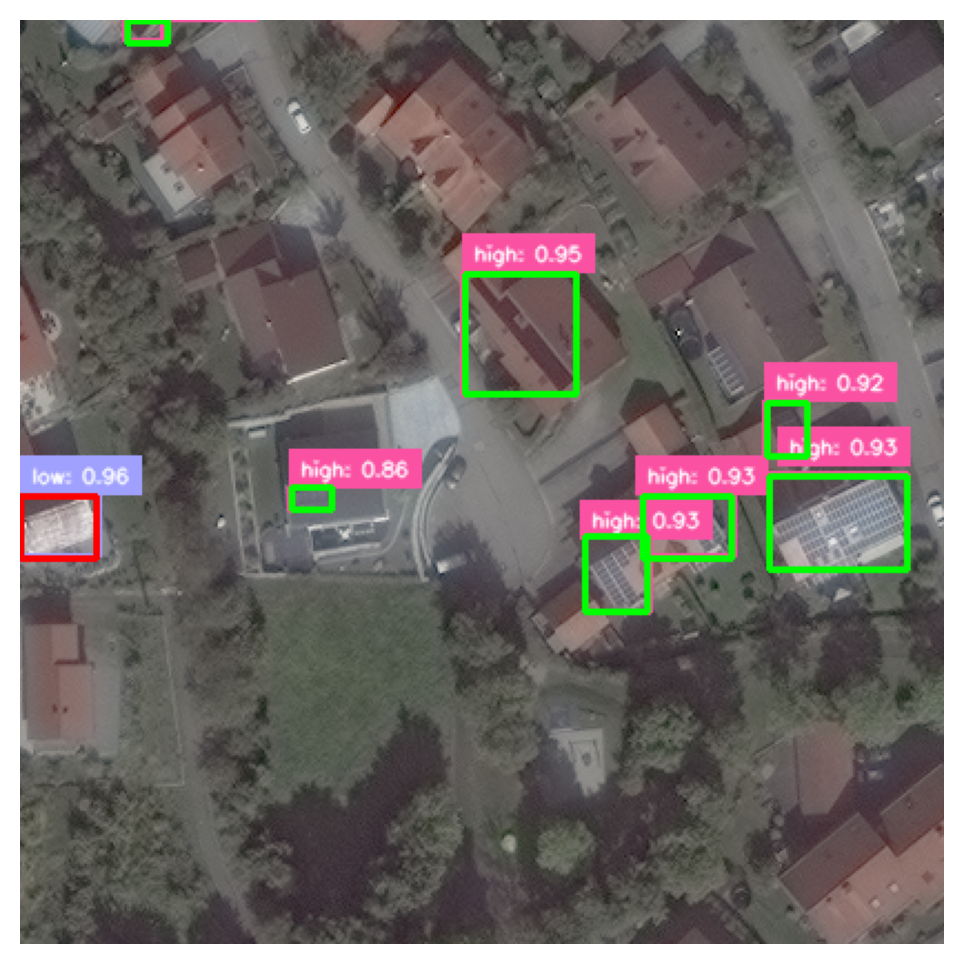


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_5975_y0_12167_dxdy_416.tif: 640x640 9 highs, 36.9ms
Speed: 2.5ms preprocess, 36.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (99, 74), (135, 106))
1 :  (0.0, (114, 62), (148, 88))
2 :  (0.0, (265, 134), (283, 150))
3 :  (0.0, (273, 128), (289, 144))
4 :  (0.0, (275, 122), (297, 140))
5 :  (0.0, (281, 305), (325, 359))
6 :  (0.0, (284, 116), (302, 134))
7 :  (0.0, (290, 110), (308, 130))
8 :  (0.0, (396, 299), (416, 343))

=================Prediction=================
0 :  (0, (98, 73), (136, 107), 0.93956876)
1 :  (0, (114, 62), (147, 89), 0.93684524)
2 :  (0, (265, 134), (283, 150), 0.86820143)
3 :  (0, (272, 127), (290, 144), 0.8352524)
4 :  (0, (274, 121), (297, 141), 0.8349731)
5 :  (0, (280, 304), (325, 359), 0.9403952)
6 :  (0, (283, 115), (303, 135), 0.866649)
7 :  (0, (288, 109), (308, 131), 0.8782533)
8 :  (0, (396, 298)

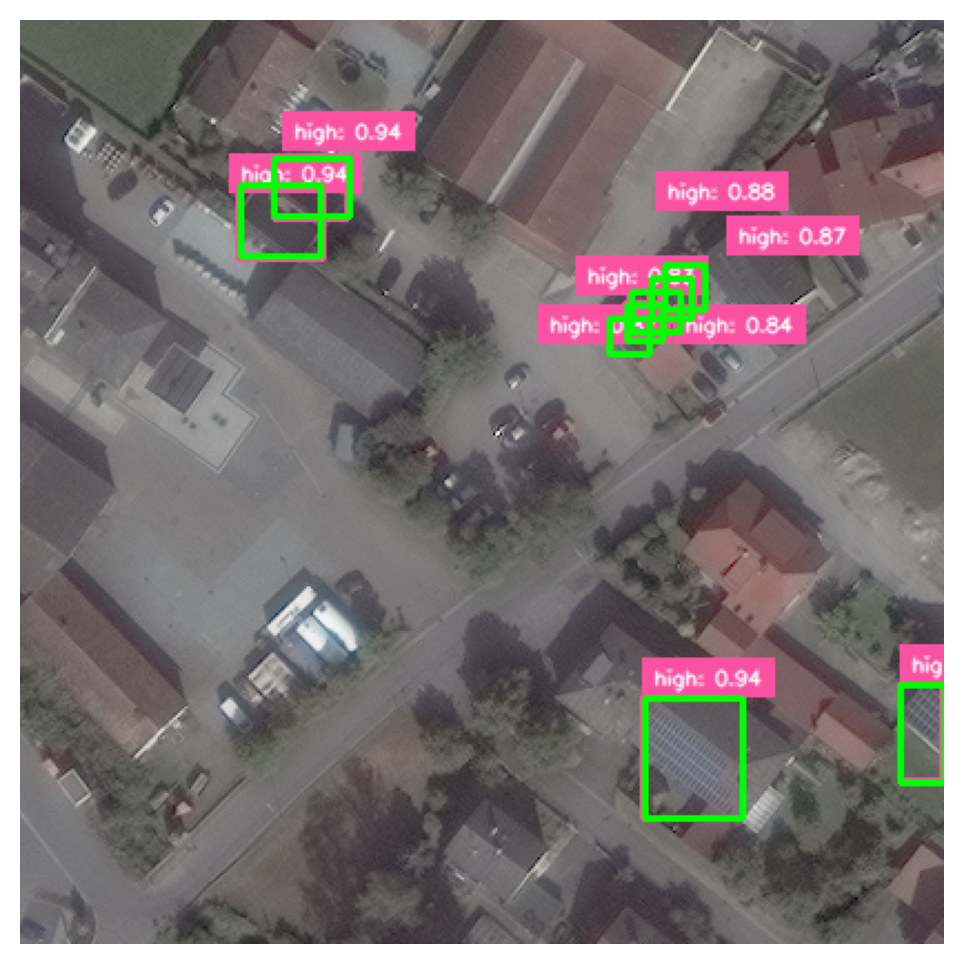


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_2__x0_8478_y0_3018_dxdy_416.tif: 640x640 4 highs, 2 moderates, 36.8ms
Speed: 2.4ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (0, 302), (8, 320))
1 :  (0.0, (4, 240), (50, 276))
2 :  (0.0, (108, 217), (140, 243))
3 :  (0.0, (323, 40), (415, 74))
4 :  (1.0, (119, 215), (167, 251))
5 :  (1.0, (131, 187), (185, 227))

=================Prediction=================
0 :  (0, (0, 302), (7, 322), 0.60488135)
1 :  (0, (4, 240), (50, 275), 0.9363185)
2 :  (0, (108, 216), (140, 242), 0.9081131)
3 :  (0, (325, 39), (416, 75), 0.92918706)
4 :  (1, (119, 215), (166, 251), 0.9467244)
5 :  (1, (130, 187), (184, 227), 0.9817692)


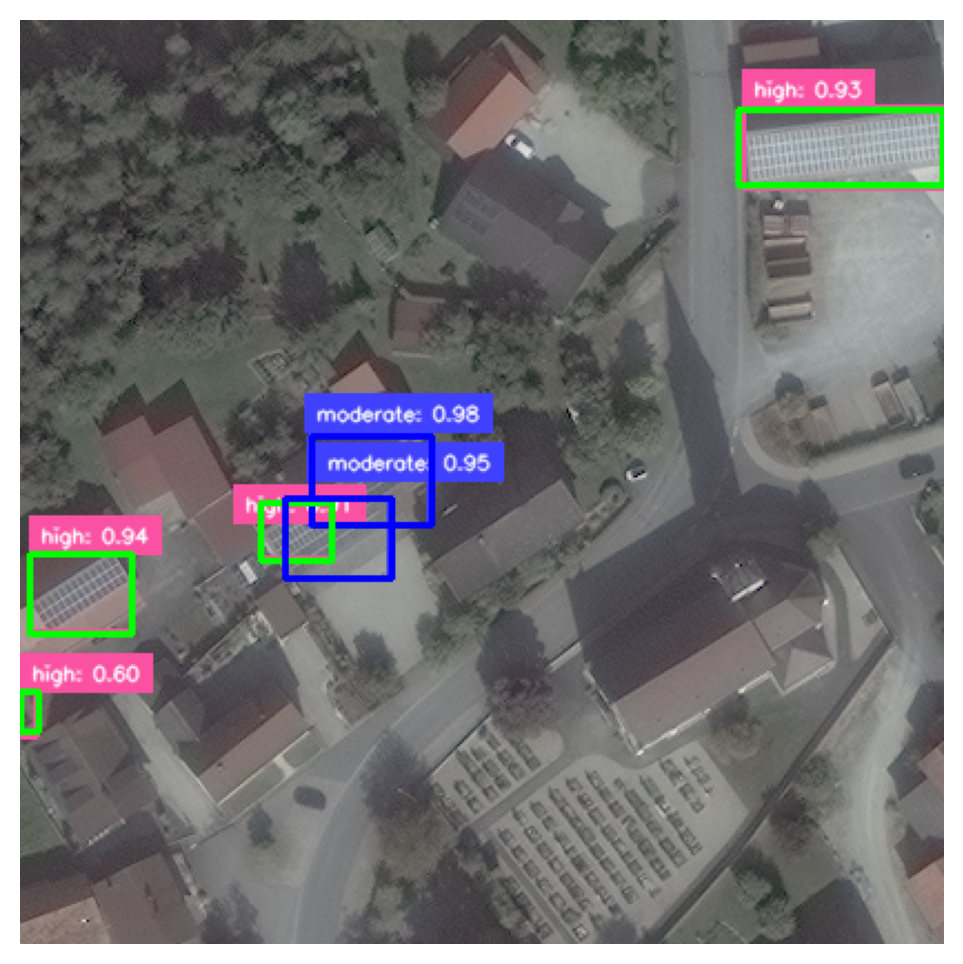


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_10277_y0_15868_dxdy_416.tif: 640x640 1 high, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (211, 226), (253, 294))

=================Prediction=================
0 :  (0, (211, 224), (254, 294), 0.94161725)


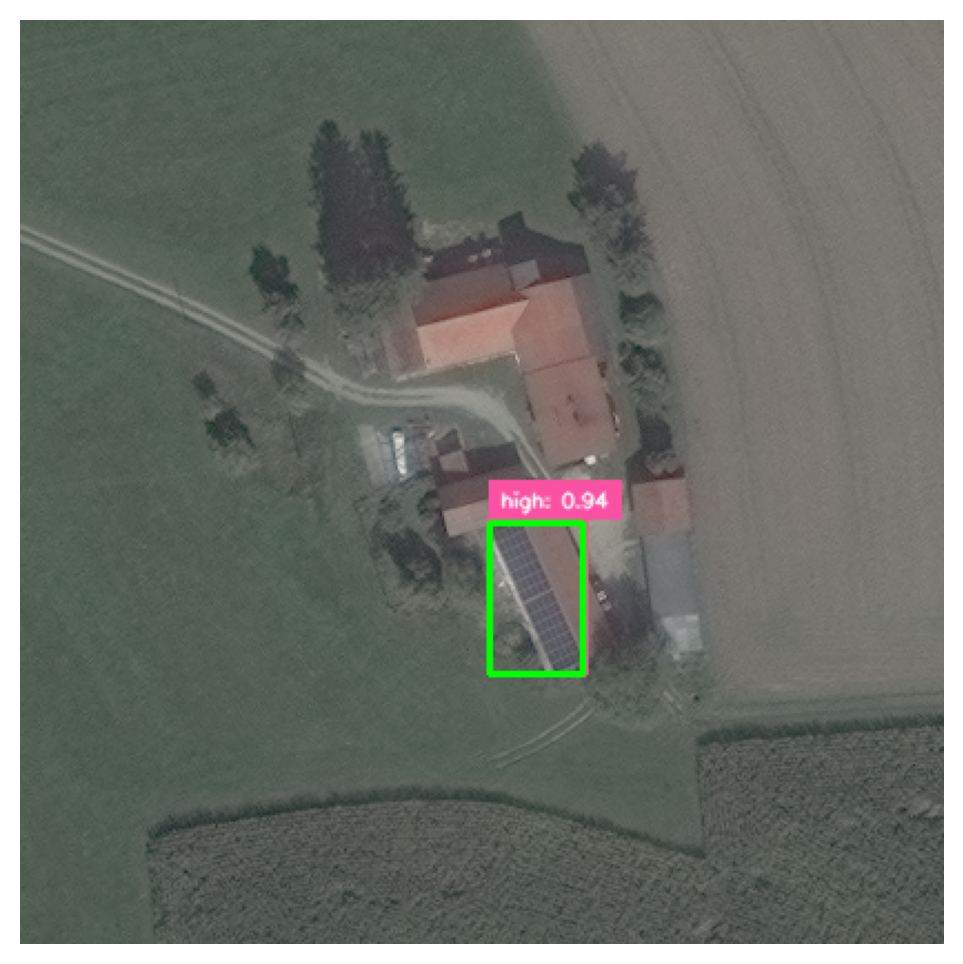


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_0_y0_7119_dxdy_416.tif: 640x640 18 highs, 1 low, 36.9ms
Speed: 3.0ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (0, 262), (22, 286))
1 :  (0.0, (1, 305), (23, 333))
2 :  (0.0, (123, 115), (147, 141))
3 :  (0.0, (132, 378), (172, 410))
4 :  (0.0, (183, 381), (207, 409))
5 :  (0.0, (249, 2), (267, 18))
6 :  (0.0, (266, 20), (282, 32))
7 :  (0.0, (277, 205), (313, 239))
8 :  (0.0, (290, 29), (312, 51))
9 :  (0.0, (336, 171), (346, 181))
10 :  (0.0, (342, 375), (362, 393))
11 :  (0.0, (351, 6), (375, 28))
12 :  (0.0, (355, 186), (365, 198))
13 :  (0.0, (358, 109), (370, 121))
14 :  (0.0, (370, 200), (396, 226))
15 :  (0.0, (372, 118), (390, 132))
16 :  (0.0, (392, 139), (408, 159))
17 :  (2.0, (150, 151), (168, 173))

=================Prediction=================
0 :  (0, (0, 262), (22, 287), 0.9086723)
1 :  (0, (0, 

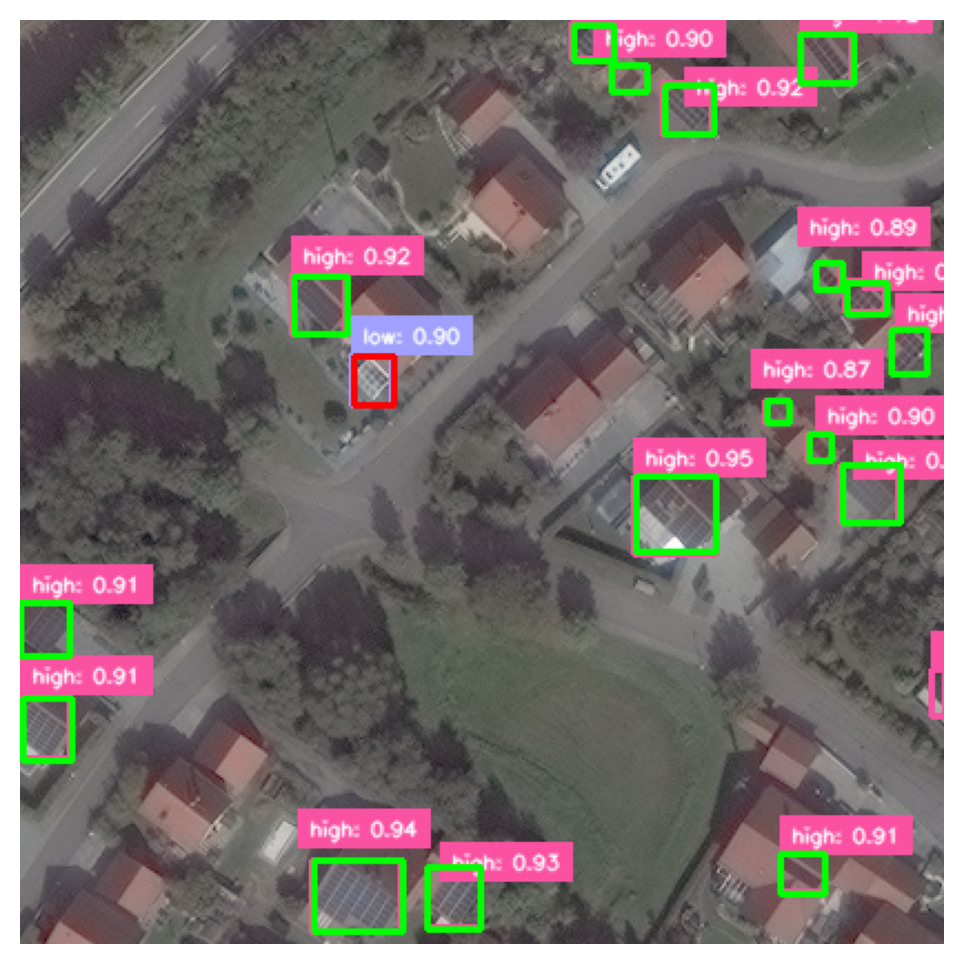


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_9847_y0_10811_dxdy_416.tif: 640x640 10 highs, 1 low, 36.8ms
Speed: 2.2ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (54, 100), (70, 112))
1 :  (0.0, (60, 399), (76, 409))
2 :  (0.0, (87, 126), (99, 136))
3 :  (0.0, (91, 115), (103, 125))
4 :  (0.0, (240, 0), (262, 16))
5 :  (0.0, (341, 106), (397, 130))
6 :  (0.0, (400, 33), (416, 59))
7 :  (0.0, (400, 376), (412, 382))
8 :  (2.0, (148, 205), (172, 223))

=================Prediction=================
0 :  (0, (54, 100), (70, 113), 0.8771997)
1 :  (0, (58, 403), (75, 415), 0.43849236)
2 :  (0, (59, 399), (75, 415), 0.43053612)
3 :  (0, (60, 397), (76, 410), 0.83215916)
4 :  (0, (86, 125), (99, 136), 0.88174164)
5 :  (0, (90, 115), (102, 125), 0.84904134)
6 :  (0, (238, 0), (262, 15), 0.8401951)
7 :  (0, (340, 106), (397, 129), 0.9345516)
8 :  (0, (400, 33), (415, 

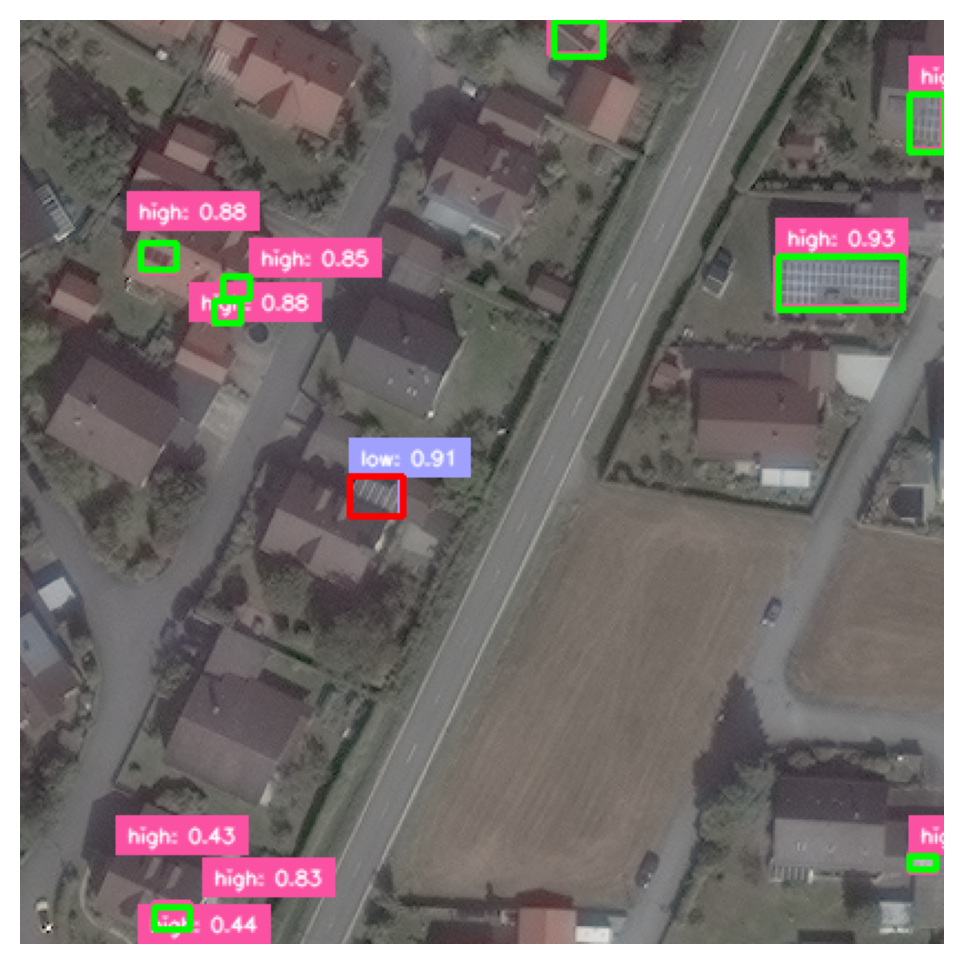


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_13756_y0_15968_dxdy_416.tif: 640x640 2 highs, 36.9ms
Speed: 2.1ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (133, 392), (191, 414))
1 :  (0.0, (213, 388), (269, 416))

=================Prediction=================
0 :  (0, (132, 392), (193, 415), 0.90054643)
1 :  (0, (210, 386), (269, 415), 0.9246368)


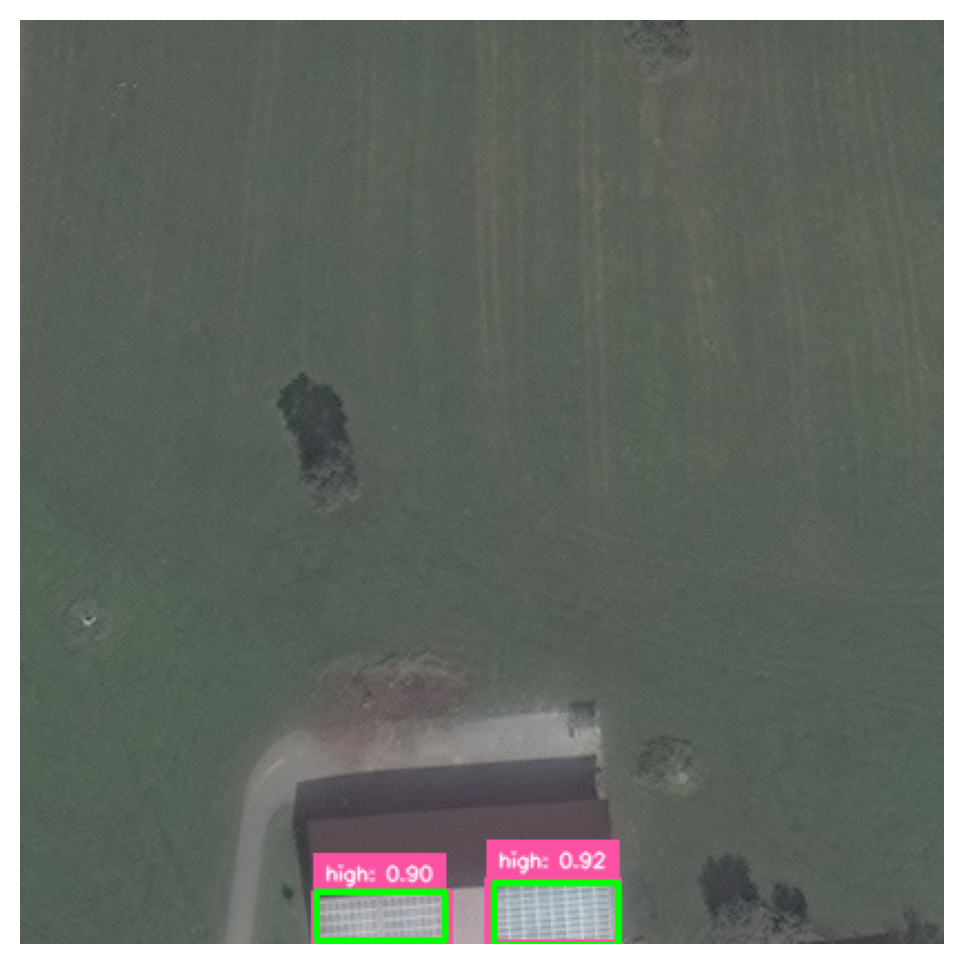


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_2__x0_6273_y0_2640_dxdy_416.tif: 640x640 7 highs, 36.9ms
Speed: 2.3ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (116, 240), (214, 320))
1 :  (0.0, (154, 200), (214, 250))
2 :  (0.0, (196, 157), (274, 217))
3 :  (0.0, (196, 308), (302, 396))
4 :  (0.0, (347, 391), (381, 415))
5 :  (0.0, (369, 376), (407, 408))
6 :  (0.0, (396, 365), (416, 381))

=================Prediction=================
0 :  (0, (118, 240), (215, 322), 0.9428232)
1 :  (0, (154, 200), (213, 250), 0.9471053)
2 :  (0, (194, 306), (304, 397), 0.94523466)
3 :  (0, (196, 157), (274, 217), 0.94904524)
4 :  (0, (347, 391), (381, 415), 0.9055823)
5 :  (0, (368, 376), (407, 408), 0.93742704)
6 :  (0, (396, 365), (415, 382), 0.88893497)


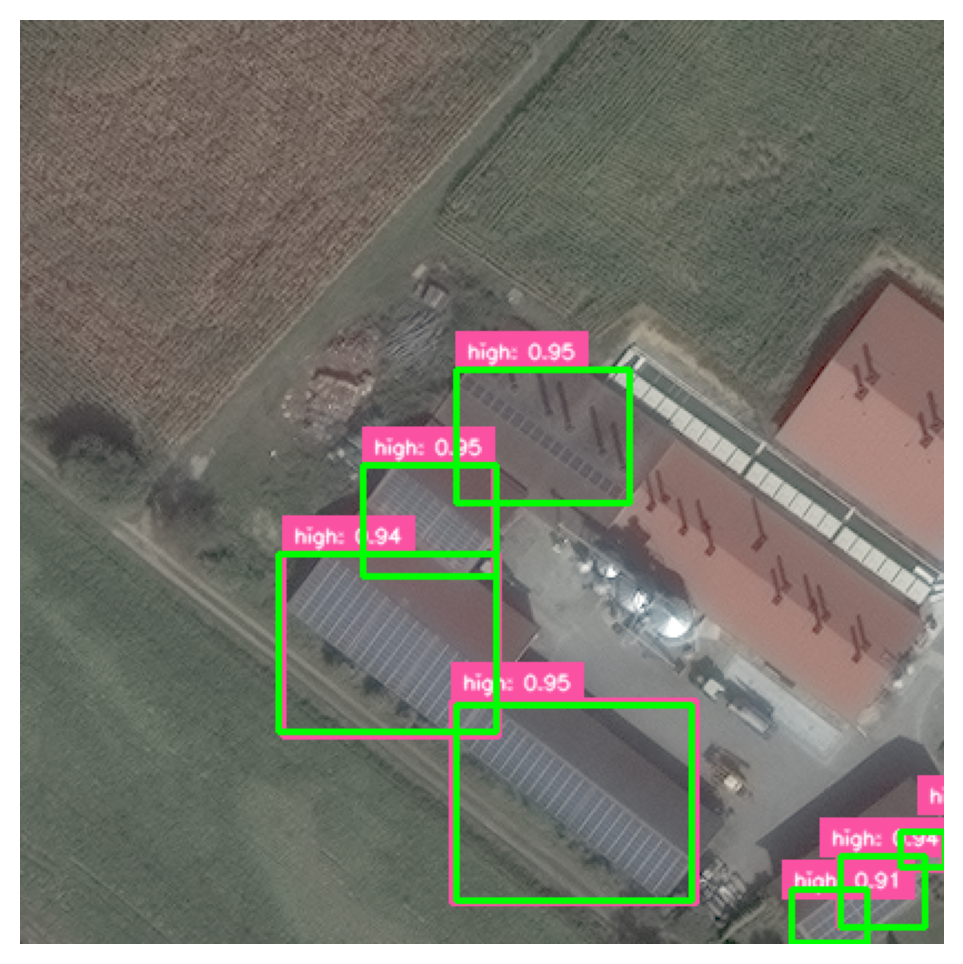


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_6425_y0_10827_dxdy_416.tif: 640x640 14 highs, 36.9ms
Speed: 3.5ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (148, 0), (218, 32))
1 :  (0.0, (198, 1), (268, 67))
2 :  (0.0, (234, 191), (280, 223))
3 :  (0.0, (237, 185), (285, 219))
4 :  (0.0, (240, 179), (288, 211))
5 :  (0.0, (244, 174), (292, 206))
6 :  (0.0, (247, 167), (271, 183))
7 :  (0.0, (252, 229), (270, 241))
8 :  (0.0, (254, 220), (272, 234))
9 :  (0.0, (259, 216), (277, 228))
10 :  (0.0, (267, 191), (339, 265))
11 :  (0.0, (281, 189), (295, 201))
12 :  (0.0, (305, 54), (407, 140))

=================Prediction=================
0 :  (0, (144, 0), (215, 33), 0.92399156)
1 :  (0, (196, 2), (266, 66), 0.94406396)
2 :  (0, (233, 188), (281, 221), 0.88141376)
3 :  (0, (237, 180), (285, 216), 0.78455484)
4 :  (0, (242, 173), (293, 210), 0.93512887)
5 :  (0, 

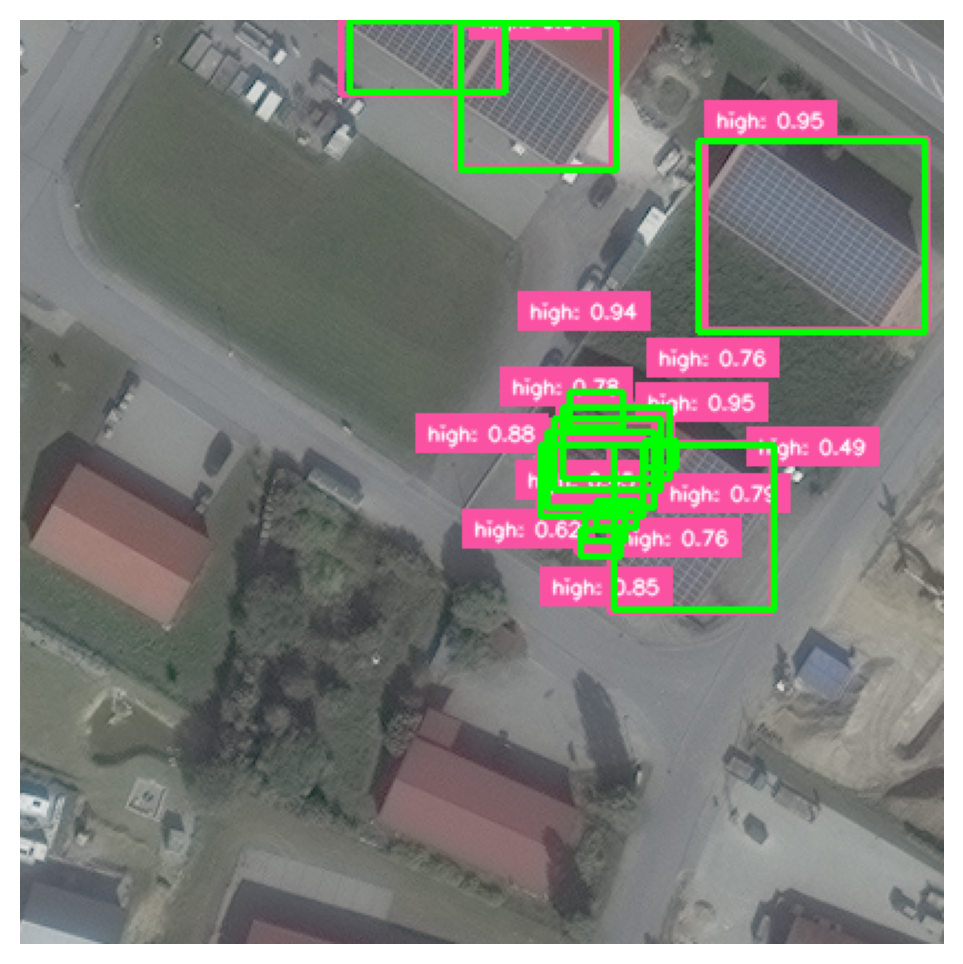


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_2884_y0_7809_dxdy_416.tif: 640x640 6 highs, 36.9ms
Speed: 2.3ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (94, 254), (148, 304))
1 :  (0.0, (178, 364), (194, 378))
2 :  (0.0, (235, 129), (255, 149))
3 :  (0.0, (330, 389), (346, 405))
4 :  (0.0, (341, 369), (357, 387))
5 :  (0.0, (382, 136), (396, 150))

=================Prediction=================
0 :  (0, (94, 254), (149, 304), 0.9434067)
1 :  (0, (177, 365), (194, 378), 0.864983)
2 :  (0, (235, 129), (255, 149), 0.90357924)
3 :  (0, (328, 388), (345, 405), 0.91845214)
4 :  (0, (340, 369), (357, 388), 0.9080471)
5 :  (0, (382, 135), (396, 149), 0.8908458)


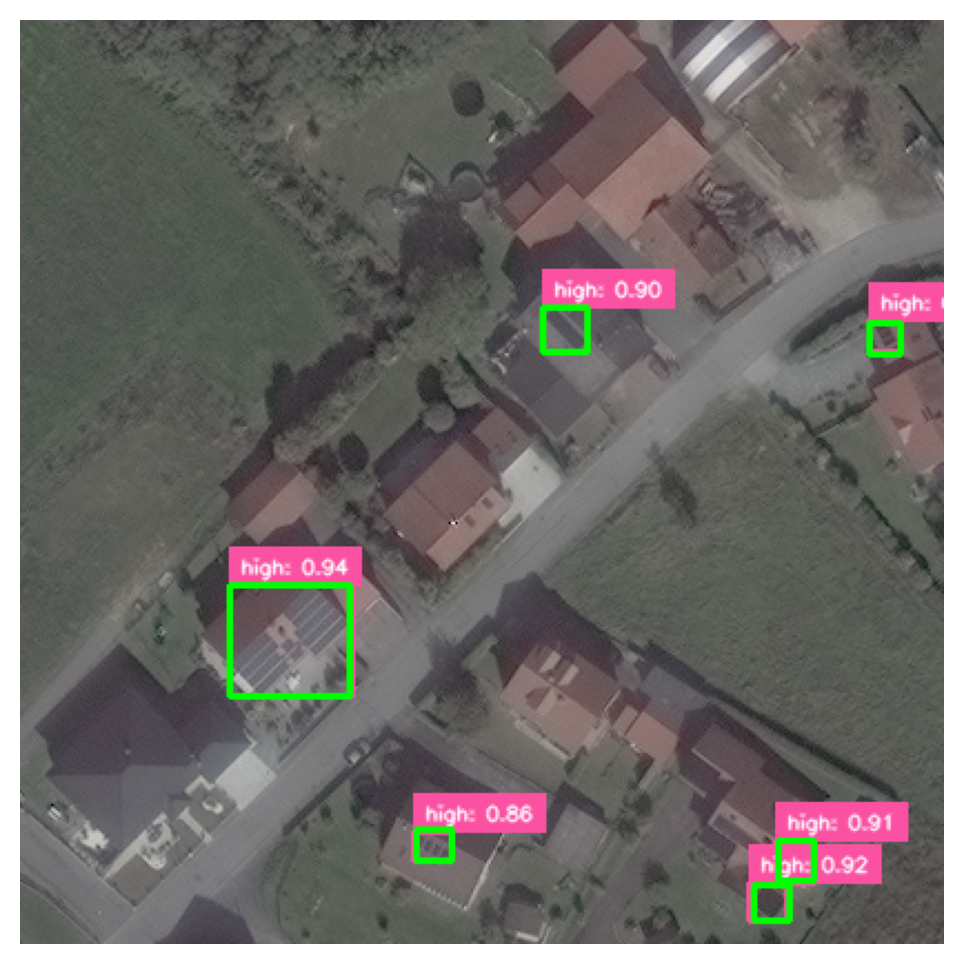


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_2__x0_9770_y0_7171_dxdy_416.tif: 640x640 5 highs, 36.9ms
Speed: 2.3ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (0, 386), (28, 416))
1 :  (0.0, (196, 178), (248, 226))
2 :  (0.0, (257, 63), (269, 75))
3 :  (0.0, (356, 150), (382, 174))
4 :  (0.0, (405, 182), (415, 212))

=================Prediction=================
0 :  (0, (0, 385), (28, 416), 0.8885155)
1 :  (0, (195, 176), (247, 226), 0.9478406)
2 :  (0, (256, 62), (268, 75), 0.88436097)
3 :  (0, (357, 150), (383, 175), 0.91560316)
4 :  (0, (403, 180), (416, 231), 0.4770716)


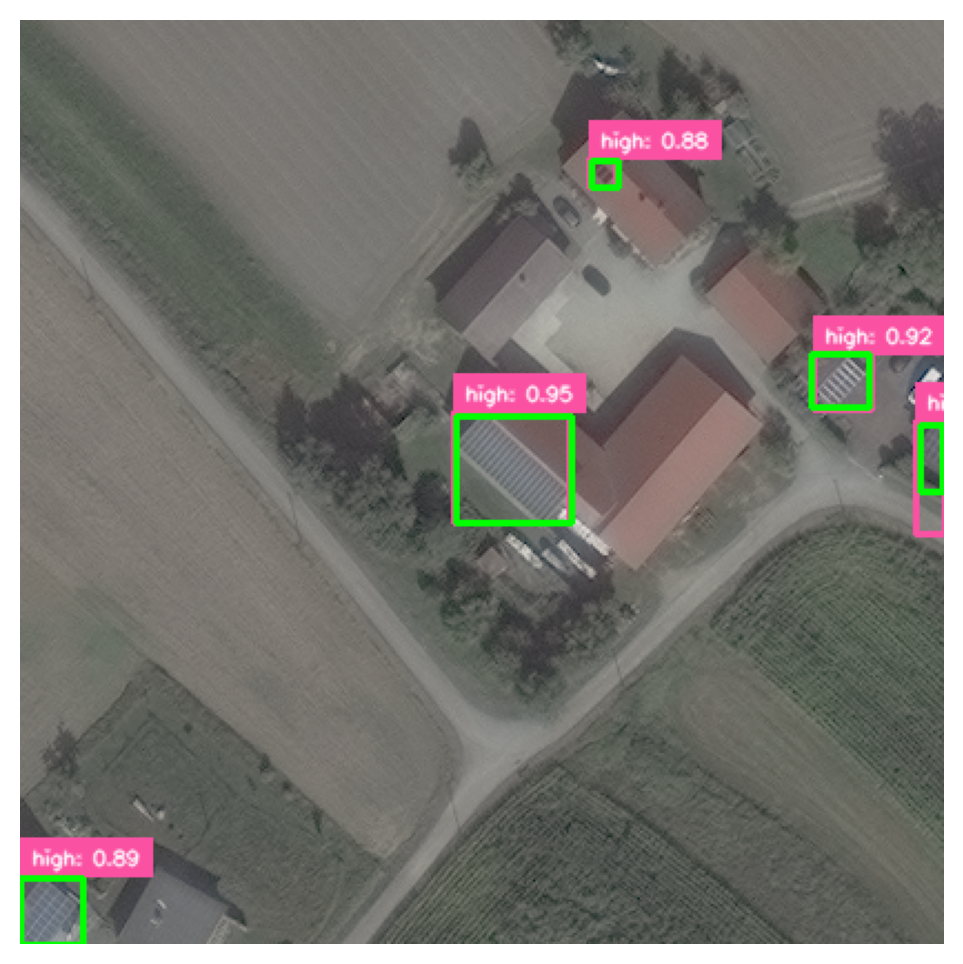


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_4033_y0_13297_dxdy_416.tif: 640x640 10 highs, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (77, 0), (137, 24))
1 :  (0.0, (136, 193), (152, 229))
2 :  (0.0, (155, 211), (167, 227))
3 :  (0.0, (178, 118), (214, 142))
4 :  (0.0, (218, 118), (264, 138))
5 :  (0.0, (224, 197), (250, 209))
6 :  (0.0, (285, 90), (311, 114))
7 :  (0.0, (309, 77), (365, 111))
8 :  (0.0, (317, 148), (347, 204))
9 :  (0.0, (337, 144), (365, 200))

=================Prediction=================
0 :  (0, (76, 0), (136, 25), 0.91760457)
1 :  (0, (135, 192), (152, 228), 0.90744394)
2 :  (0, (154, 210), (166, 227), 0.88908577)
3 :  (0, (178, 118), (214, 141), 0.91896284)
4 :  (0, (217, 118), (264, 138), 0.9196532)
5 :  (0, (224, 197), (251, 210), 0.8933474)
6 :  (0, (285, 90), (310, 114), 0.9282018)
7 :  (0, (309, 77), (365, 11

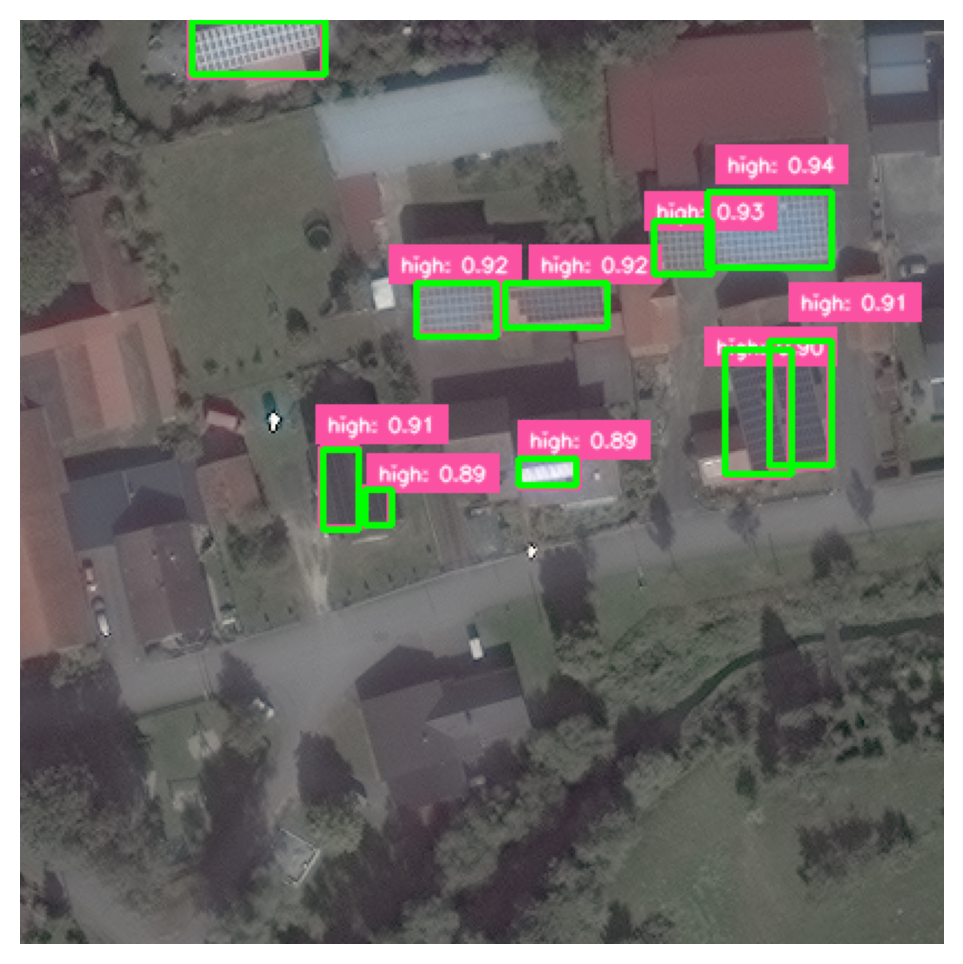


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_4769_y0_13391_dxdy_416.tif: 640x640 2 highs, 36.8ms
Speed: 2.3ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (38, 239), (56, 249))
1 :  (0.0, (181, 0), (211, 6))
2 :  (0.0, (204, 219), (218, 229))

=================Prediction=================
0 :  (0, (35, 239), (54, 250), 0.8522825)
1 :  (0, (202, 218), (220, 229), 0.75753)


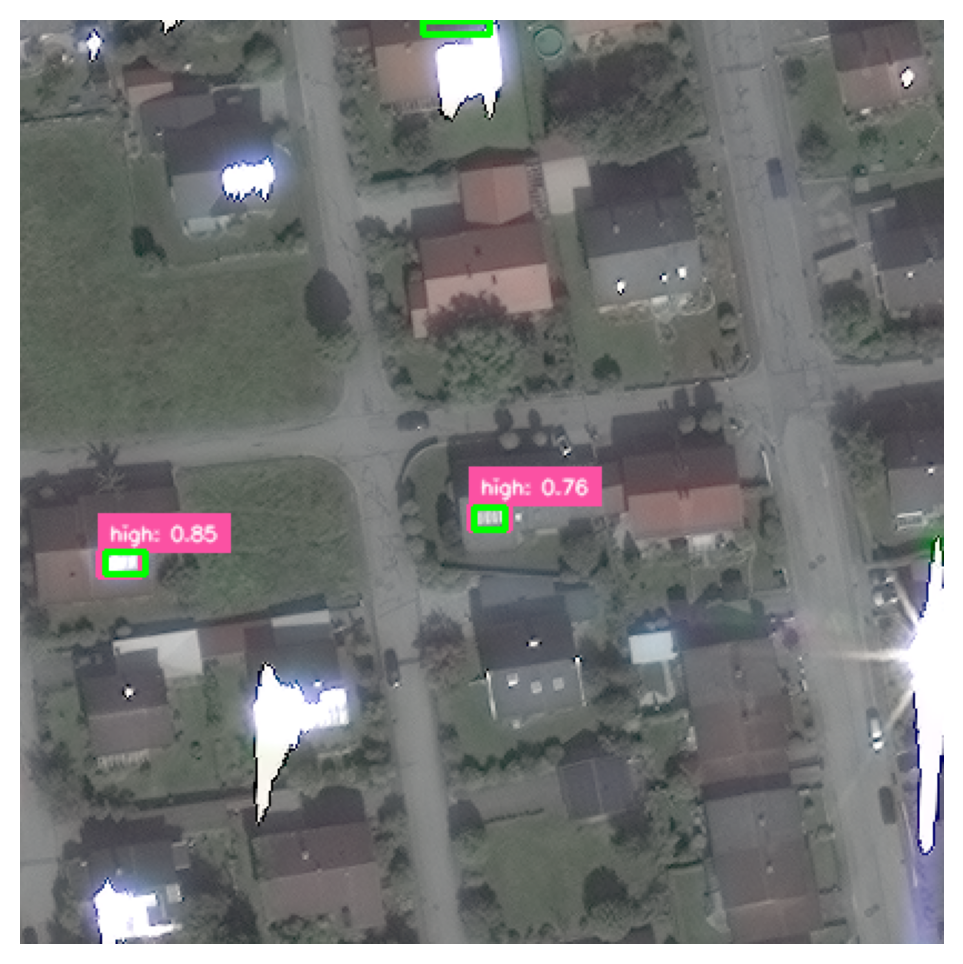


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_3662_y0_15968_dxdy_416.tif: 640x640 4 highs, 36.8ms
Speed: 2.3ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (86, 394), (130, 414))
1 :  (0.0, (114, 375), (162, 415))
2 :  (0.0, (142, 357), (190, 403))
3 :  (0.0, (171, 343), (209, 383))

=================Prediction=================
0 :  (0, (87, 393), (131, 416), 0.9028266)
1 :  (0, (113, 375), (161, 416), 0.94822294)
2 :  (0, (142, 357), (189, 402), 0.95469326)
3 :  (0, (171, 343), (209, 385), 0.94786006)


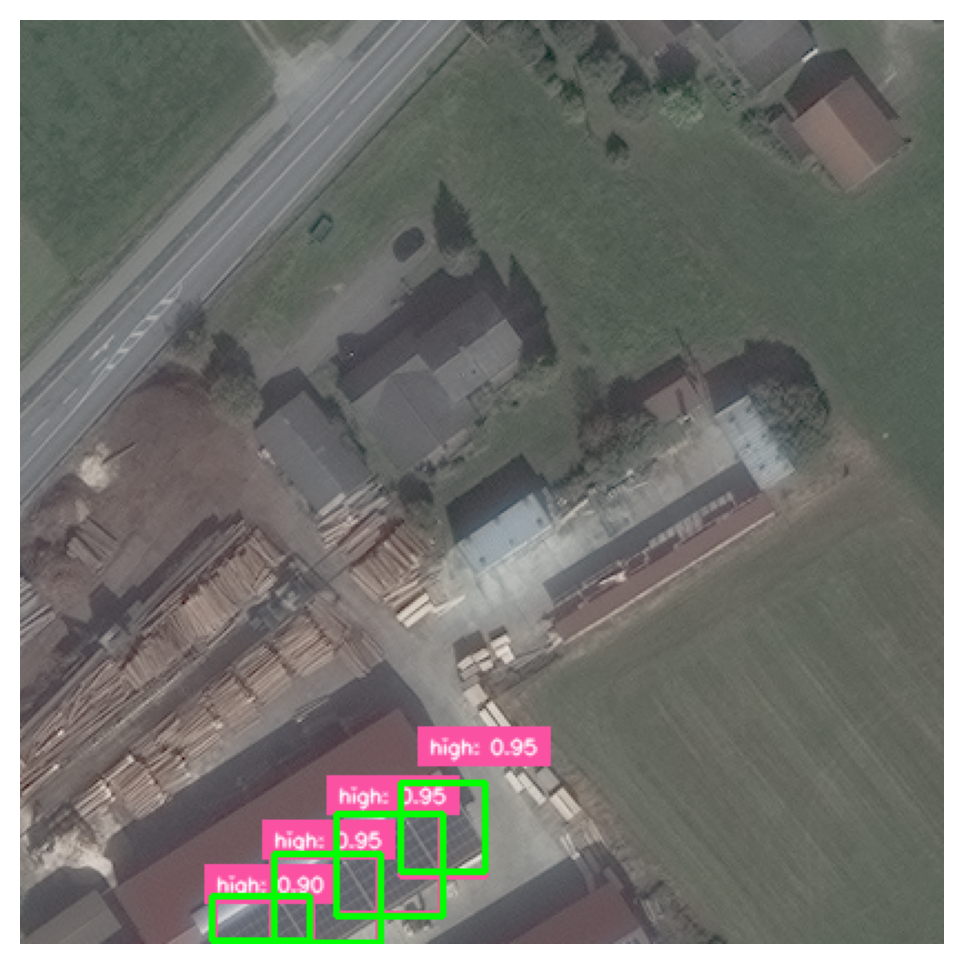


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_952_y0_7237_dxdy_416.tif: 640x640 9 highs, 36.8ms
Speed: 2.2ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (0, 387), (12, 415))
1 :  (0.0, (24, 343), (52, 375))
2 :  (0.0, (56, 349), (86, 375))
3 :  (0.0, (115, 389), (133, 407))
4 :  (0.0, (135, 203), (175, 247))
5 :  (0.0, (254, 183), (266, 203))
6 :  (0.0, (260, 375), (278, 389))
7 :  (0.0, (269, 156), (285, 178))
8 :  (0.0, (334, 246), (362, 274))

=================Prediction=================
0 :  (0, (0, 388), (12, 415), 0.7338248)
1 :  (0, (23, 342), (52, 375), 0.91112626)
2 :  (0, (56, 349), (87, 375), 0.92065483)
3 :  (0, (115, 389), (132, 407), 0.9094248)
4 :  (0, (135, 203), (175, 247), 0.94141084)
5 :  (0, (254, 182), (266, 202), 0.8727226)
6 :  (0, (260, 374), (277, 390), 0.9055449)
7 :  (0, (268, 156), (286, 178), 0.9094533)
8 :  (0, (334, 246), (362,

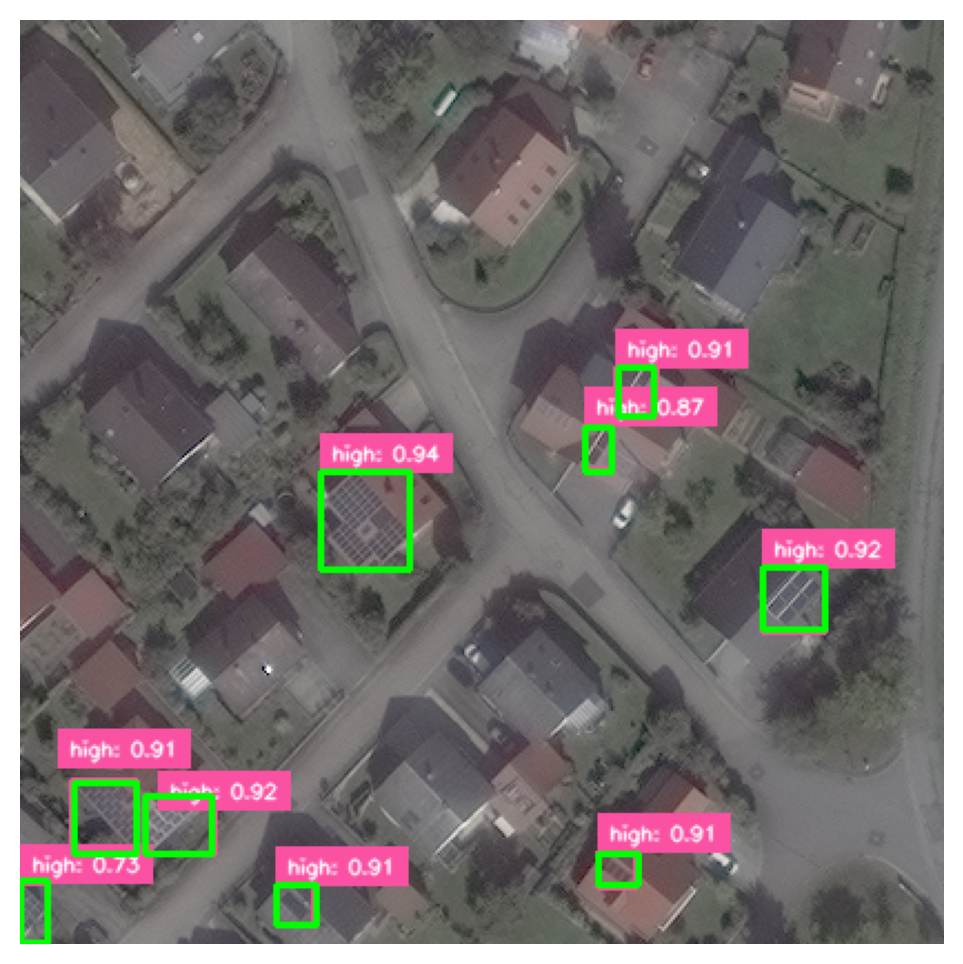


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_8414_y0_8045_dxdy_416.tif: 640x640 7 highs, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (98, 49), (112, 63))
1 :  (0.0, (153, 150), (177, 168))
2 :  (0.0, (172, 167), (198, 185))
3 :  (0.0, (262, 133), (290, 161))
4 :  (0.0, (276, 171), (326, 199))
5 :  (0.0, (313, 180), (325, 188))
6 :  (0.0, (393, 235), (415, 265))

=================Prediction=================
0 :  (0, (97, 49), (112, 63), 0.8967054)
1 :  (0, (153, 149), (178, 167), 0.9131068)
2 :  (0, (172, 166), (197, 184), 0.89771825)
3 :  (0, (261, 132), (290, 160), 0.9377756)
4 :  (0, (276, 170), (326, 198), 0.9228279)
5 :  (0, (312, 179), (326, 188), 0.7773091)
6 :  (0, (393, 234), (415, 261), 0.7554551)


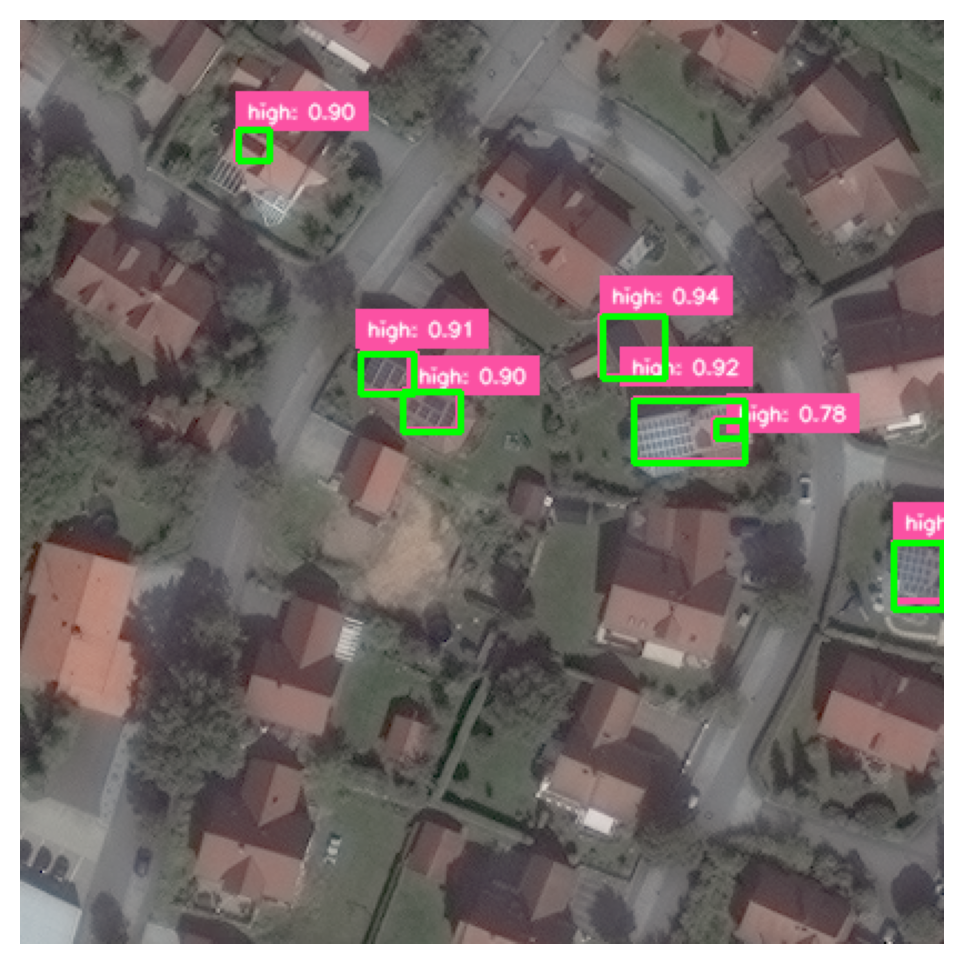


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_5801_y0_11021_dxdy_416.tif: 640x640 10 highs, 36.8ms
Speed: 2.2ms preprocess, 36.8ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (207, 176), (249, 224))
1 :  (0.0, (234, 36), (274, 76))
2 :  (0.0, (238, 185), (280, 231))
3 :  (0.0, (267, 44), (307, 90))
4 :  (0.0, (270, 196), (310, 242))
5 :  (0.0, (299, 53), (337, 97))
6 :  (0.0, (300, 206), (338, 250))
7 :  (0.0, (328, 65), (364, 109))
8 :  (0.0, (329, 213), (371, 259))
9 :  (0.0, (356, 72), (398, 120))

=================Prediction=================
0 :  (0, (204, 176), (247, 220), 0.94101)
1 :  (0, (234, 35), (275, 76), 0.9451292)
2 :  (0, (236, 186), (280, 230), 0.94371045)
3 :  (0, (266, 45), (307, 90), 0.940802)
4 :  (0, (268, 196), (310, 239), 0.944066)
5 :  (0, (297, 55), (336, 99), 0.9412768)
6 :  (0, (299, 204), (339, 248), 0.9478587)
7 :  (0, (326, 64), (366, 108), 0.9431

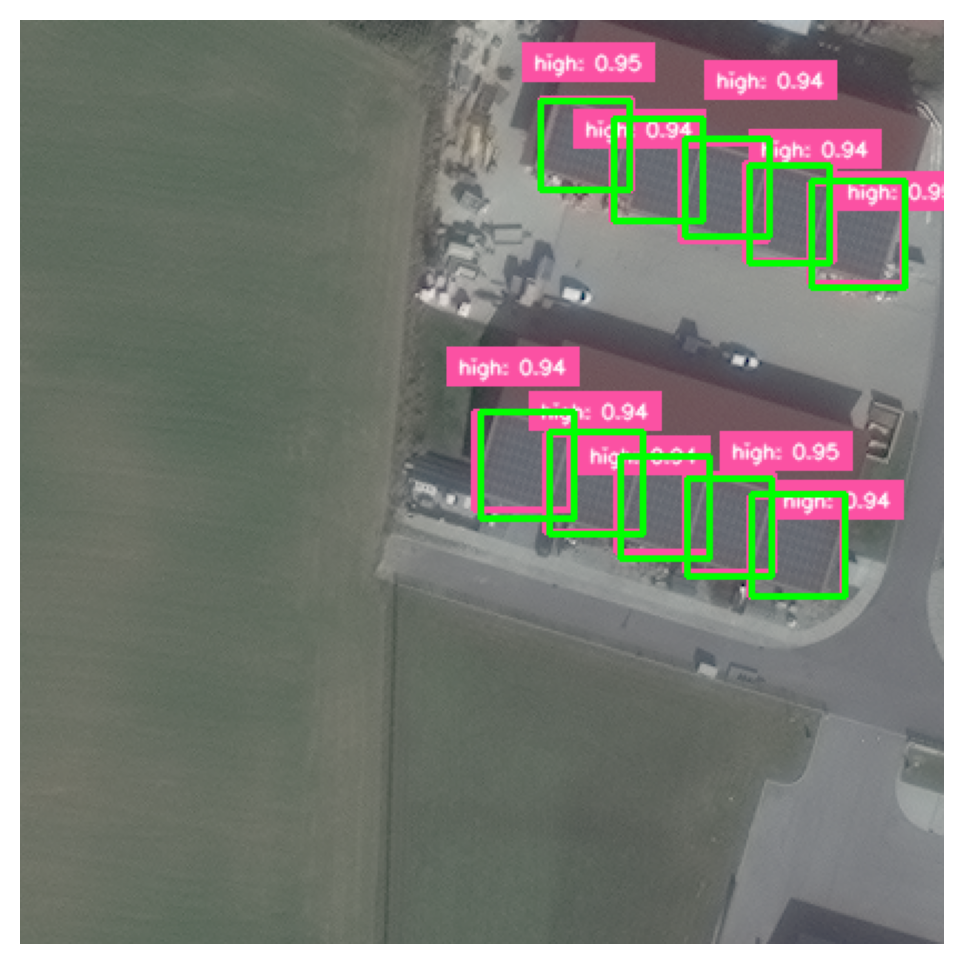


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_2__x0_4083_y0_5890_dxdy_416.tif: 640x640 4 highs, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (87, 166), (127, 216))
1 :  (0.0, (103, 112), (135, 154))
2 :  (0.0, (114, 120), (148, 162))
3 :  (0.0, (117, 220), (141, 236))

=================Prediction=================
0 :  (0, (86, 166), (128, 215), 0.93831295)
1 :  (0, (102, 112), (136, 154), 0.93050265)
2 :  (0, (114, 119), (147, 162), 0.94694984)
3 :  (0, (117, 220), (140, 236), 0.9001826)


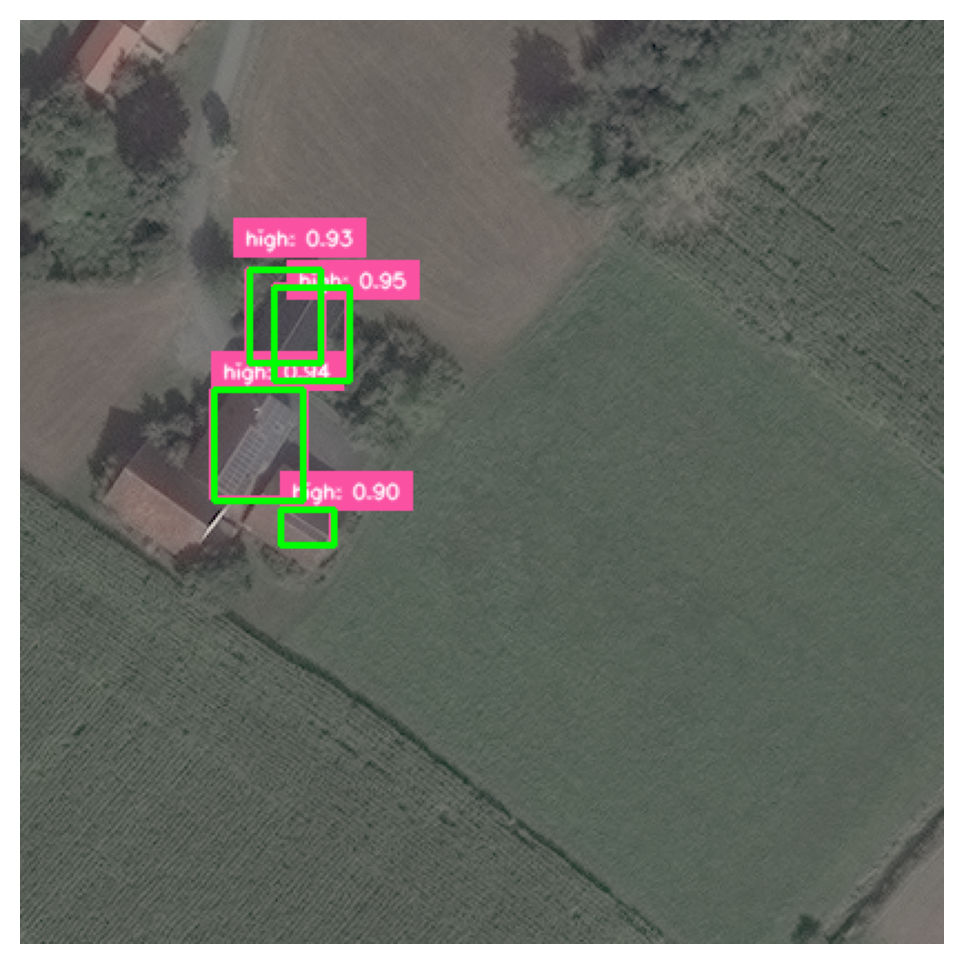


image 1/1 /kaggle/input/satellite-aisg/data/test/images/solarpanels_native_3__x0_8472_y0_11412_dxdy_416.tif: 640x640 3 highs, 36.9ms
Speed: 2.2ms preprocess, 36.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)
=================Original=================
0 :  (0.0, (61, 121), (95, 137))
1 :  (0.0, (122, 70), (146, 86))
2 :  (0.0, (128, 94), (144, 100))
3 :  (0.0, (174, 204), (194, 214))
4 :  (0.0, (191, 200), (215, 222))

=================Prediction=================
0 :  (0, (62, 120), (96, 137), 0.917692)
1 :  (0, (121, 68), (145, 77), 0.28038117)
2 :  (0, (172, 201), (214, 220), 0.8776862)


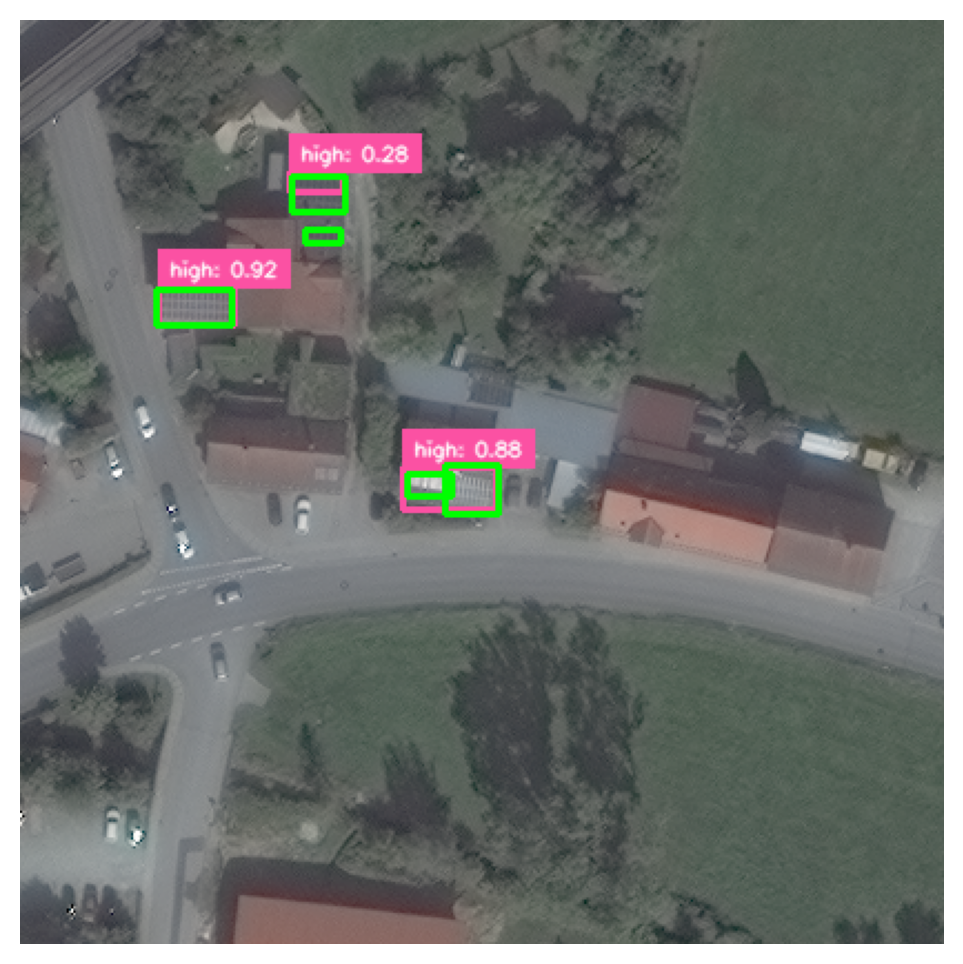

In [16]:
random_samples = random.sample(test_images, 20)

for img_path in random_samples:
    label_path = img_path.replace("images", "labels").replace(".tif", ".txt")
    give_image(img_path, model, label_path)

# Using `supervision.metrics`

In [6]:
img = cv2.imread("/kaggle/input/satellite-aisg/data/test/images/solarpanels_native_1__x0_9671_y0_10745_dxdy_416.tif")
img_shape = img.shape
print(img_shape)
img_shape = img_shape[0]

(416, 416, 3)


In [10]:
test_images = glob.glob(f"{dataset_location}/test/images/*.tif")

predictions = []
for img_path in sorted(test_images):
    results = model.predict(img_path, verbose = False)
    for result in results:
        boxes = result.boxes.xyxy.cpu().numpy()
        scores = result.boxes.conf.cpu().numpy()
        labels = result.boxes.cls.cpu().numpy().astype(int)
        predictions.append(
            sv.Detections(
                xyxy=boxes,
                confidence=scores,
                class_id=labels
            )
        )

In [11]:
test_labels = glob.glob(f"{dataset_location}/test/labels/*.txt")

ground_truths = []
for label_path in sorted(test_labels):
    with open(label_path, "r") as f:
        lines = f.readlines()
    boxes, labels = [], []
    for line in lines:
        class_id, x_center, y_center, w, h = map(float, line.strip().split())
        
        x_min = (x_center - w / 2) * img_shape
        y_min = (y_center - h / 2) * img_shape
        x_max = (x_center + w / 2) * img_shape
        y_max = (y_center + h / 2) * img_shape
        
        boxes.append([x_min, y_min, x_max, y_max])
        labels.append(int(class_id))
    ground_truths.append(
        sv.Detections(
            xyxy=np.array(boxes),
            class_id=np.array(labels)
        )
    )

In [12]:
len(predictions), len(ground_truths)

(508, 508)

# mAP50

In [22]:
map_metric = sv.MeanAveragePrecision.from_detections(
    predictions=predictions,
    targets=ground_truths
)

In [23]:
map_metric.map50

0.9485268573382882

In [24]:
map_metric.map75

0.9350079176632121

In [25]:
map_metric.map50_95

0.9011177774270568

In [26]:
map_metric.per_class_ap50_95

array([[    0.98213,     0.98064,     0.97864,     0.97693,     0.97125,     0.96309,     0.94876,     0.92028,     0.85802,      0.6562],
       [    0.94436,     0.94436,     0.92285,     0.92285,     0.92285,     0.92285,     0.92285,     0.92285,     0.92285,     0.75432],
       [    0.91909,     0.91909,     0.91909,     0.91909,     0.91909,     0.91909,     0.91909,     0.91909,     0.85269,     0.48922]])

# Precision, Recall, F1 Score

## Confusion Matrix with Background Class [Predictions along horizontal axis and Ground Truth on the vertical axis]

Confusion Matrix:
[[       5661           0           0         182]
 [          1          25           0           2]
 [          3           0          40           4]
 [        213           1           3           0]]


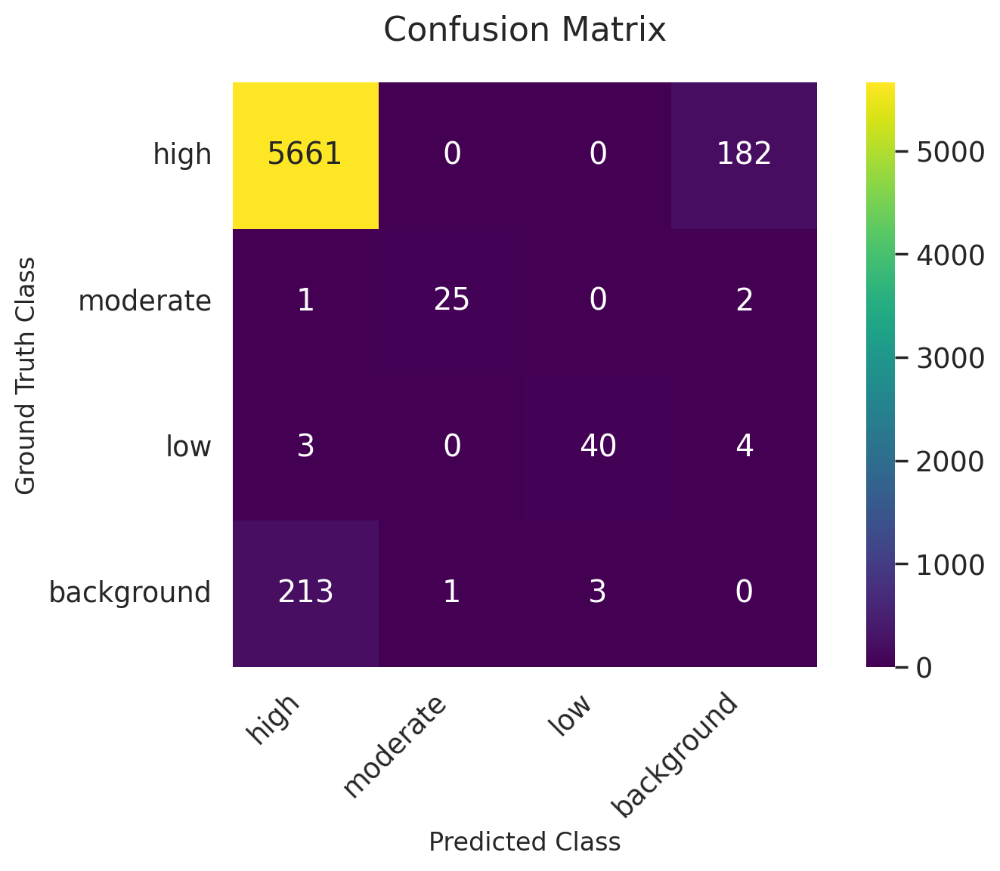

In [35]:
cm = sv.ConfusionMatrix.from_detections(
            predictions=predictions,
            targets=ground_truths,
            classes=["high", "moderate", "low"]
        )


confusion_matrix = cm.matrix
print("Confusion Matrix:")
print(confusion_matrix)

class_labels = cm.classes + ["background"]

sns.set(style="whitegrid", palette="viridis", font_scale=1.2)

plt.figure(figsize=(8, 6))
sns.heatmap(
    confusion_matrix,
    annot=True,
    cmap="viridis",
    fmt = "g",
    xticklabels=class_labels,
    yticklabels=class_labels,
    cbar=True,
    square=True
)

plt.xlabel("Predicted Class", fontsize=12)
plt.ylabel("Ground Truth Class", fontsize=12)
plt.title("Confusion Matrix", fontsize=16, pad=20)
plt.xticks(rotation=45, ha="right")
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

In [27]:
iou_thresholds = [0.1, 0.3, 0.5, 0.7, 0.9]
conf_thresholds = [0.1, 0.3, 0.5, 0.7, 0.9]
classes = ["high", "moderate", "low"]

metrics_table = {
    "IoU": [],
    "Conf": [],
    "Class": [],
    "Precision": [],
    "Recall": [],
    "F1": []
}

for iou_th in iou_thresholds:
    for conf_th in conf_thresholds:

        filtered_preds = [
            sv.Detections(
                xyxy=p.xyxy[p.confidence >= conf_th],
                confidence=p.confidence[p.confidence >= conf_th],
                class_id=p.class_id[p.confidence >= conf_th]
            )
            for p in predictions
        ]
        
        cm = sv.ConfusionMatrix.from_detections(
            predictions=filtered_preds,
            targets=ground_truths,
            classes=classes,
            iou_threshold=iou_th,
            conf_threshold = conf_th
        )
        
        confusion_matrix = cm.matrix
        n_classes = len(classes)  # 3 classes, excluding background
        
        # Per-class TP, FP, FN
        for class_idx, class_name in enumerate(classes):
            tp = confusion_matrix[class_idx, class_idx]
            fp = confusion_matrix[:, class_idx].sum() - tp
            fn = confusion_matrix[class_idx, :].sum() - tp
            
            precision = tp / (tp + fp) if (tp + fp) > 0 else 0
            recall = tp / (tp + fn) if (tp + fn) > 0 else 0
            f1 = 2 * (precision * recall) / (precision + recall) if (precision + recall) > 0 else 0
            
            metrics_table["IoU"].append(iou_th)
            metrics_table["Conf"].append(conf_th)
            metrics_table["Class"].append(class_name)
            metrics_table["Precision"].append(precision)
            metrics_table["Recall"].append(recall)
            metrics_table["F1"].append(f1)

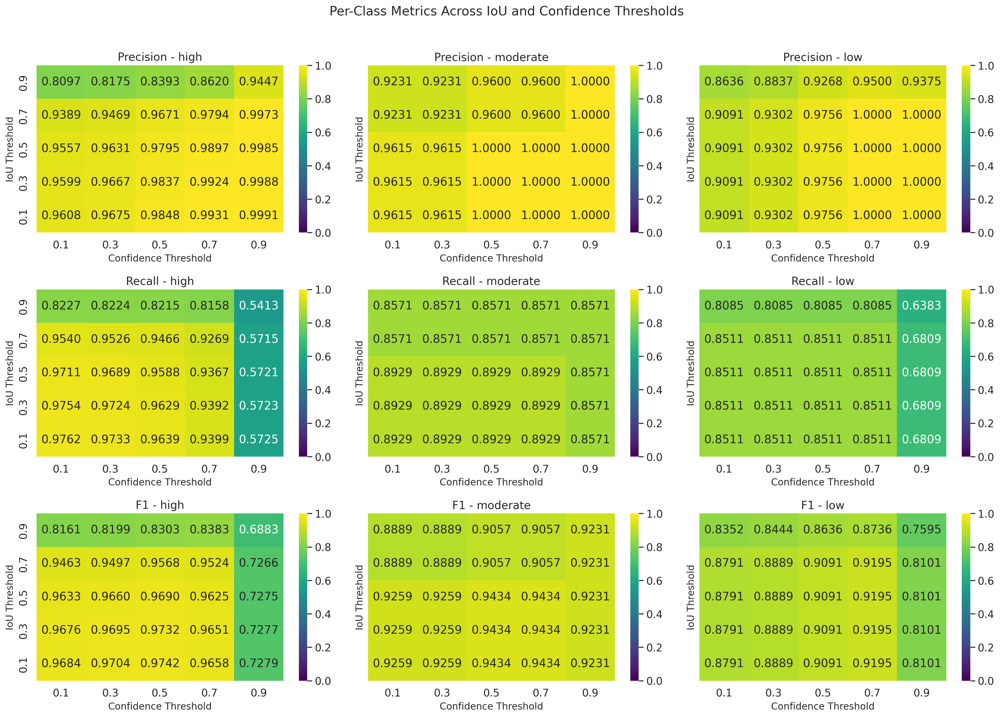

In [31]:
df = pd.DataFrame(metrics_table)

sns.set(style="whitegrid", palette="viridis", font_scale=1.2)

metrics = ["Precision", "Recall", "F1"]
fig, axes = plt.subplots(nrows=len(metrics), ncols=len(classes), figsize=(18, 12), sharey=True)

for i, metric in enumerate(metrics):
    for j, class_name in enumerate(classes):
        class_df = df[df["Class"] == class_name]
        pivot = class_df.pivot(index="IoU", columns="Conf", values=metric)
        
        ax = axes[i, j]
        sns.heatmap(
            pivot,
            annot=True,
            fmt=".4f",
            cmap="viridis",
            vmin=0, vmax=1,
            cbar=True,
            ax=ax
        )
        
        ax.set_title(f"{metric} - {class_name}", fontsize=14)
        ax.set_xlabel("Confidence Threshold", fontsize=12)
        ax.set_ylabel("IoU Threshold", fontsize=12)
        ax.invert_yaxis()

plt.tight_layout()
plt.suptitle("Per-Class Metrics Across IoU and Confidence Thresholds", fontsize=16, y=1.05)
plt.show()

# BONUS PART - FOR INDIA!!!
# [Scraped out Images](https://www.kaggle.com/datasets/guntassinghsaran/satellite-iitgn/data)

### IIT Delhi Campus


image 1/1 /kaggle/input/satellite-iitgn/satellite111.tif: 640x640 11 highs, 37.0ms
Speed: 2.7ms preprocess, 37.0ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (0, 169), (145, 237), 0.69796187)
1 :  (0, (1, 148), (141, 208), 0.3556217)
2 :  (0, (47, 282), (210, 367), 0.53225076)
3 :  (0, (55, 360), (113, 396), 0.79543567)
4 :  (0, (119, 313), (238, 371), 0.79104906)
5 :  (0, (194, 73), (321, 133), 0.8784478)
6 :  (0, (197, 125), (263, 160), 0.8648629)
7 :  (0, (233, 202), (416, 288), 0.5922109)
8 :  (0, (265, 245), (416, 313), 0.79896784)
9 :  (0, (271, 73), (394, 134), 0.8813107)
10 :  (0, (310, 43), (395, 87), 0.81960315)


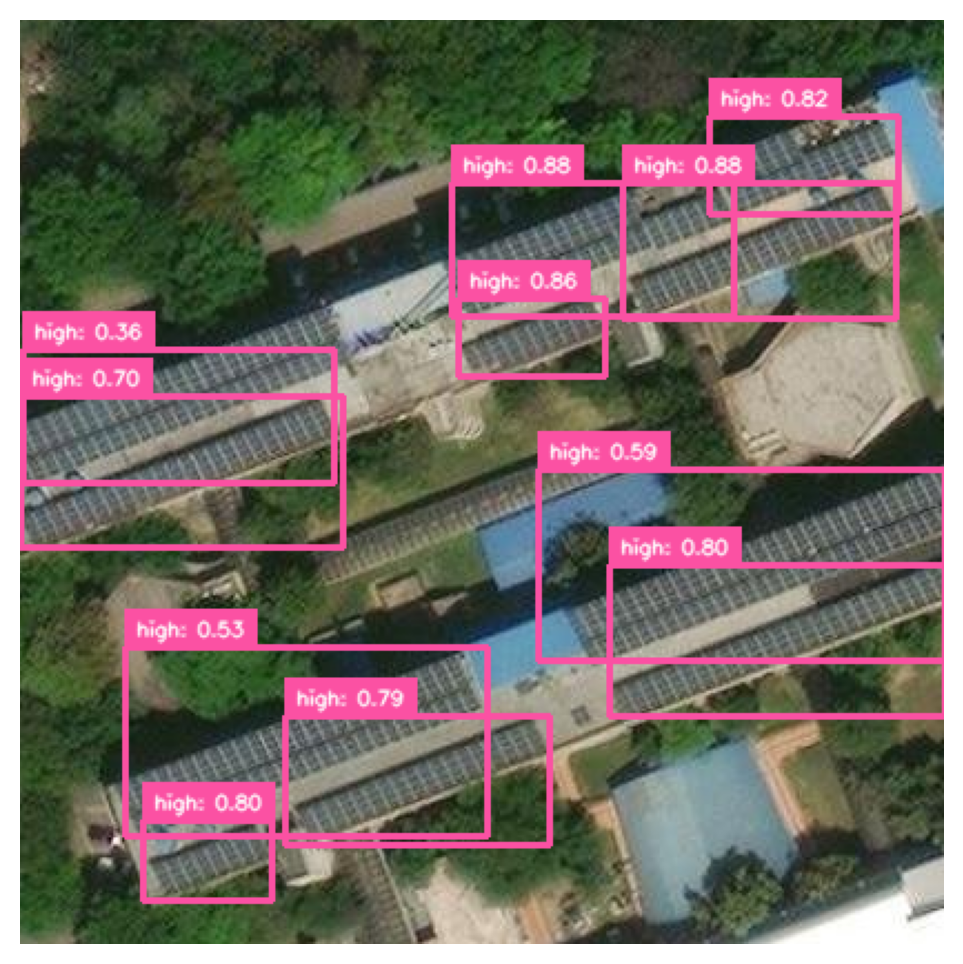

In [17]:
test_img = "/kaggle/input/satellite-iitgn/satellite111.tif"
give_image(test_img, model)


image 1/1 /kaggle/input/satellite-iitgn/satellite112.tif: 640x640 16 highs, 36.9ms
Speed: 2.6ms preprocess, 36.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (0, 134), (49, 169), 0.6199024)
1 :  (0, (0, 293), (97, 348), 0.40826547)
2 :  (0, (30, 180), (305, 283), 0.53711134)
3 :  (0, (43, 100), (136, 150), 0.7958224)
4 :  (0, (88, 199), (312, 308), 0.275484)
5 :  (0, (144, 42), (292, 110), 0.37931374)
6 :  (0, (298, 175), (404, 230), 0.8580297)
7 :  (0, (317, 83), (355, 111), 0.8759239)
8 :  (0, (326, 107), (365, 136), 0.8962102)
9 :  (0, (337, 325), (410, 367), 0.8127885)
10 :  (0, (345, 350), (416, 391), 0.83959335)
11 :  (0, (357, 202), (393, 230), 0.86347866)
12 :  (0, (366, 223), (406, 252), 0.8853983)
13 :  (0, (376, 246), (415, 274), 0.82266474)
14 :  (0, (392, 172), (415, 215), 0.39176798)
15 :  (0, (392, 187), (416, 215), 0.56139797)


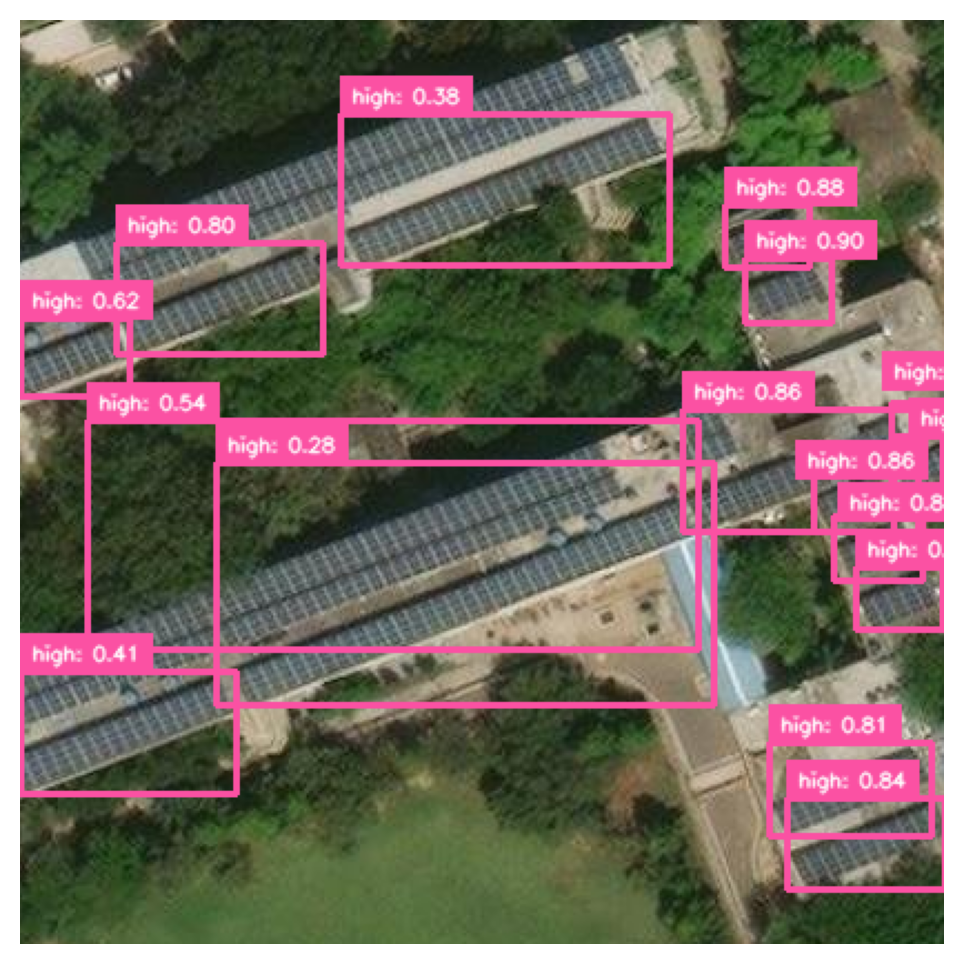

In [18]:
test_img = "/kaggle/input/satellite-iitgn/satellite112.tif"
give_image(test_img, model)


image 1/1 /kaggle/input/satellite-iitgn/satellite113.tif: 640x640 13 highs, 36.9ms
Speed: 2.3ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (25, 294), (150, 361), 0.89824724)
1 :  (0, (29, 137), (114, 193), 0.89257306)
2 :  (0, (45, 345), (117, 384), 0.91098535)
3 :  (0, (63, 290), (97, 316), 0.86593735)
4 :  (0, (94, 0), (171, 17), 0.33050603)
5 :  (0, (118, 267), (164, 296), 0.8997595)
6 :  (0, (140, 254), (260, 320), 0.93814665)
7 :  (0, (146, 0), (175, 19), 0.8199589)
8 :  (0, (175, 250), (209, 274), 0.88507164)
9 :  (0, (191, 288), (270, 331), 0.9204761)
10 :  (0, (335, 150), (398, 185), 0.64745086)
11 :  (0, (335, 150), (403, 198), 0.87129277)
12 :  (0, (355, 179), (416, 222), 0.8064501)


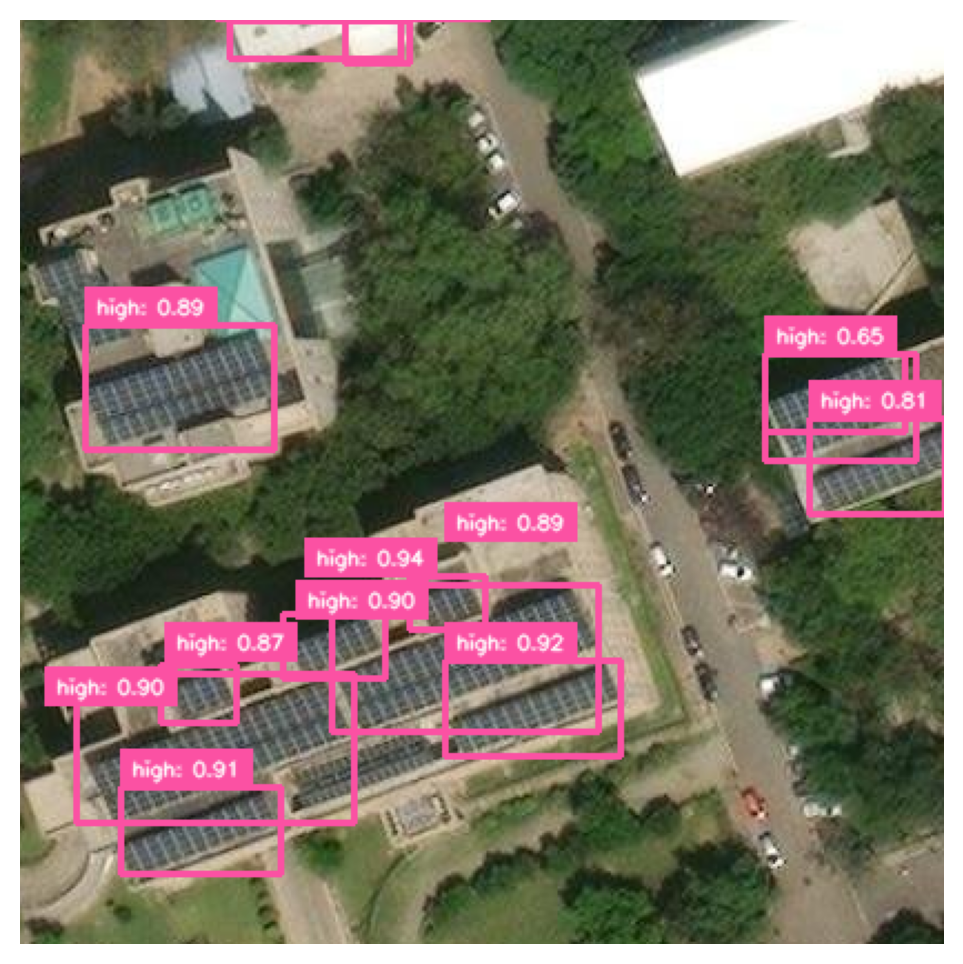

In [19]:
test_img = "/kaggle/input/satellite-iitgn/satellite113.tif"
give_image(test_img, model)

### Kochin Airport Parking (false solar panels sheds)


image 1/1 /kaggle/input/satellite-iitgn/satellite91.tif: 640x640 1 high, 36.9ms
Speed: 2.4ms preprocess, 36.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (41, 0), (174, 10), 0.3882681)


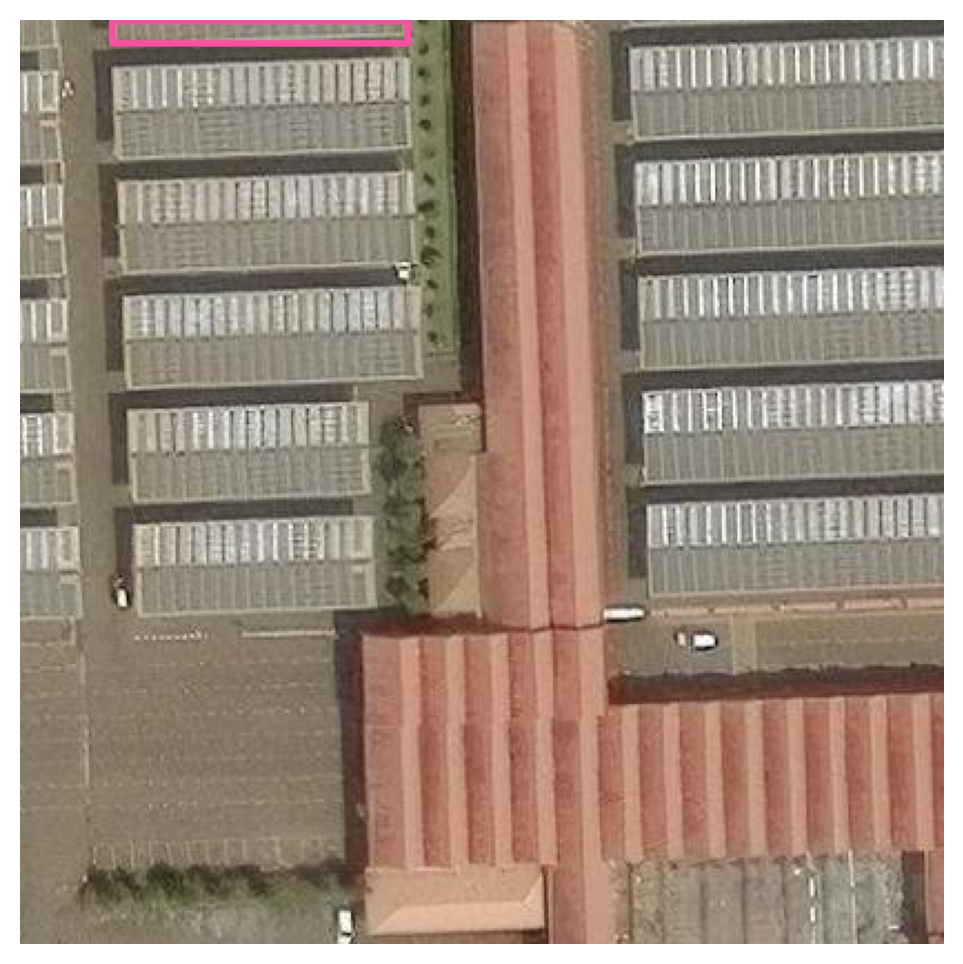

In [20]:
test_img = "/kaggle/input/satellite-iitgn/satellite91.tif"
give_image(test_img, model)

### IITGN Hostel


image 1/1 /kaggle/input/satellite-iitgn/satellite61.tif: 640x640 45 highs, 36.9ms
Speed: 2.6ms preprocess, 36.9ms inference, 1.5ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (15, 45), (40, 55), 0.84567404)
1 :  (0, (15, 55), (40, 65), 0.8434714)
2 :  (0, (16, 68), (47, 80), 0.8116959)
3 :  (0, (16, 79), (48, 90), 0.8525983)
4 :  (0, (16, 100), (48, 110), 0.8722573)
5 :  (0, (16, 111), (48, 121), 0.8819438)
6 :  (0, (16, 239), (62, 271), 0.3535932)
7 :  (0, (17, 90), (48, 100), 0.859771)
8 :  (0, (17, 122), (48, 132), 0.89285135)
9 :  (0, (17, 134), (35, 142), 0.70277154)
10 :  (0, (17, 143), (33, 152), 0.670646)
11 :  (0, (22, 305), (48, 315), 0.46820238)
12 :  (0, (22, 316), (48, 325), 0.627322)
13 :  (0, (24, 327), (48, 335), 0.6518885)
14 :  (0, (24, 337), (49, 346), 0.75482994)
15 :  (0, (26, 347), (49, 355), 0.745662)
16 :  (0, (28, 357), (49, 366), 0.8486412)
17 :  (0, (29, 368), (49, 376), 0.8574175)
18 :  (0, (41, 33)

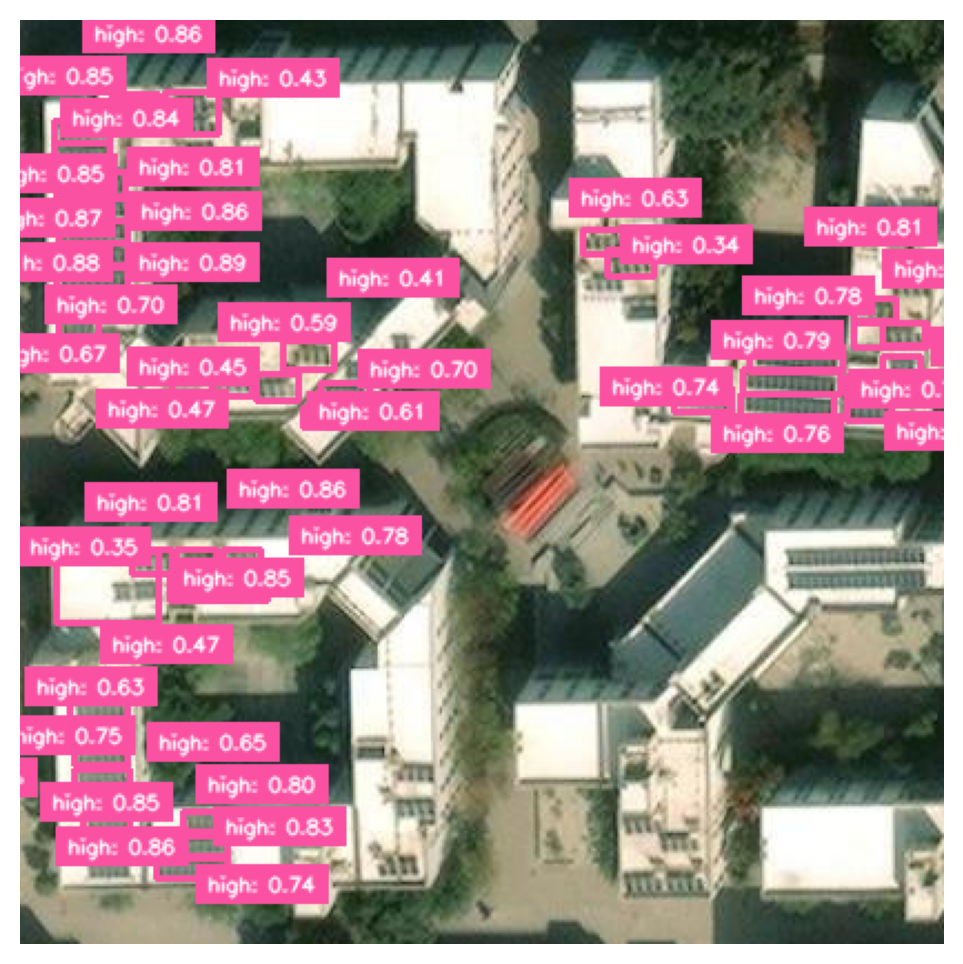

In [21]:
test_img = "/kaggle/input/satellite-iitgn/satellite61.tif"
give_image(test_img, model)

### IITGN Acad Area


image 1/1 /kaggle/input/satellite-iitgn/satellite81.tif: 640x640 21 highs, 37.0ms
Speed: 2.7ms preprocess, 37.0ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (21, 364), (45, 379), 0.39681324)
1 :  (0, (25, 378), (45, 385), 0.36306438)
2 :  (0, (25, 382), (45, 394), 0.32389072)
3 :  (0, (33, 327), (170, 347), 0.590639)
4 :  (0, (52, 362), (66, 371), 0.2851217)
5 :  (0, (71, 363), (93, 375), 0.7010867)
6 :  (0, (72, 297), (95, 319), 0.42990538)
7 :  (0, (72, 381), (92, 395), 0.7021544)
8 :  (0, (82, 216), (159, 236), 0.6496576)
9 :  (0, (104, 237), (125, 261), 0.6028382)
10 :  (0, (110, 360), (130, 374), 0.49113607)
11 :  (0, (113, 215), (214, 236), 0.29370114)
12 :  (0, (177, 237), (216, 260), 0.7645278)
13 :  (0, (217, 101), (244, 114), 0.81983024)
14 :  (0, (248, 102), (302, 114), 0.54451287)
15 :  (0, (303, 99), (331, 113), 0.8042275)
16 :  (0, (335, 98), (363, 112), 0.8387266)
17 :  (0, (379, 4), (415, 15),

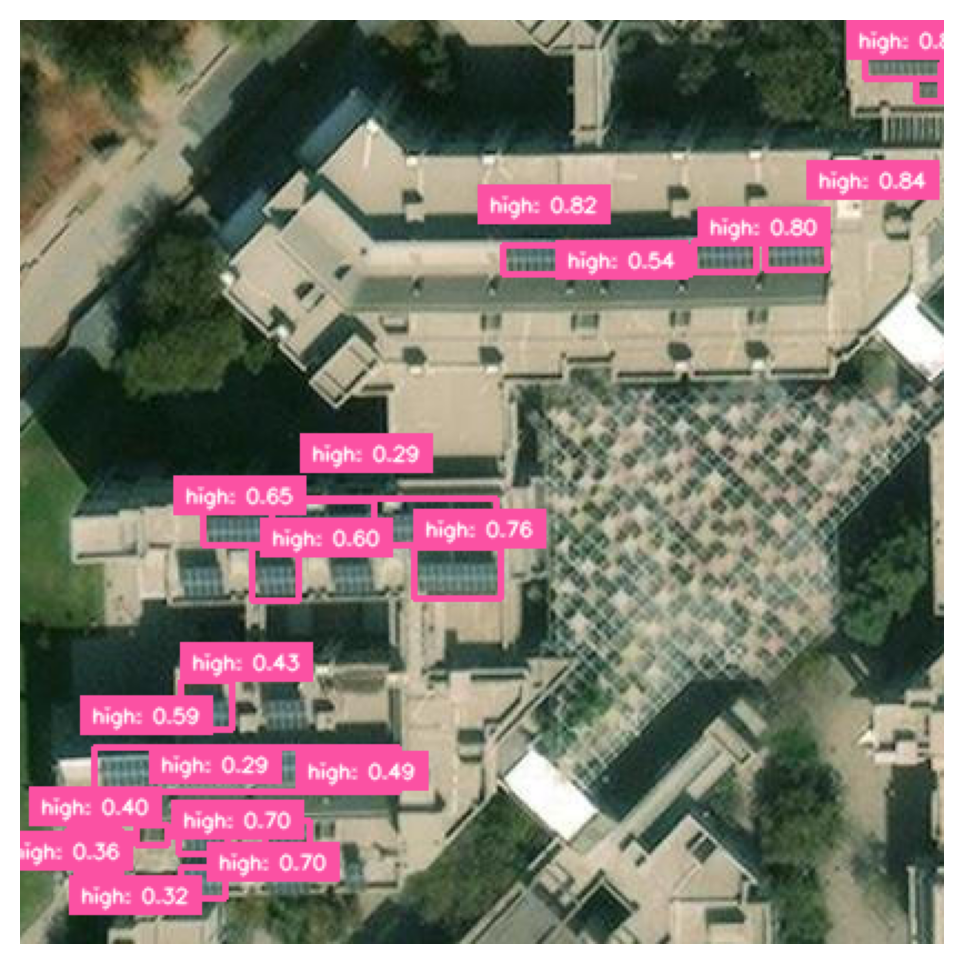

In [22]:
test_img = "/kaggle/input/satellite-iitgn/satellite81.tif"
give_image(test_img, model)

### Honolulu, Hawaii


image 1/1 /kaggle/input/satellite-iitgn/satellite121.tif: 640x640 9 highs, 37.2ms
Speed: 2.5ms preprocess, 37.2ms inference, 1.6ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (40, 33), (67, 63), 0.65175974)
1 :  (0, (103, 259), (124, 289), 0.4581612)
2 :  (0, (113, 342), (134, 366), 0.7254093)
3 :  (0, (120, 273), (135, 285), 0.45154345)
4 :  (0, (135, 295), (163, 316), 0.8786329)
5 :  (0, (244, 0), (271, 14), 0.3058125)
6 :  (0, (258, 392), (273, 408), 0.8060521)
7 :  (0, (313, 294), (337, 321), 0.6329956)
8 :  (0, (334, 296), (350, 310), 0.6137146)


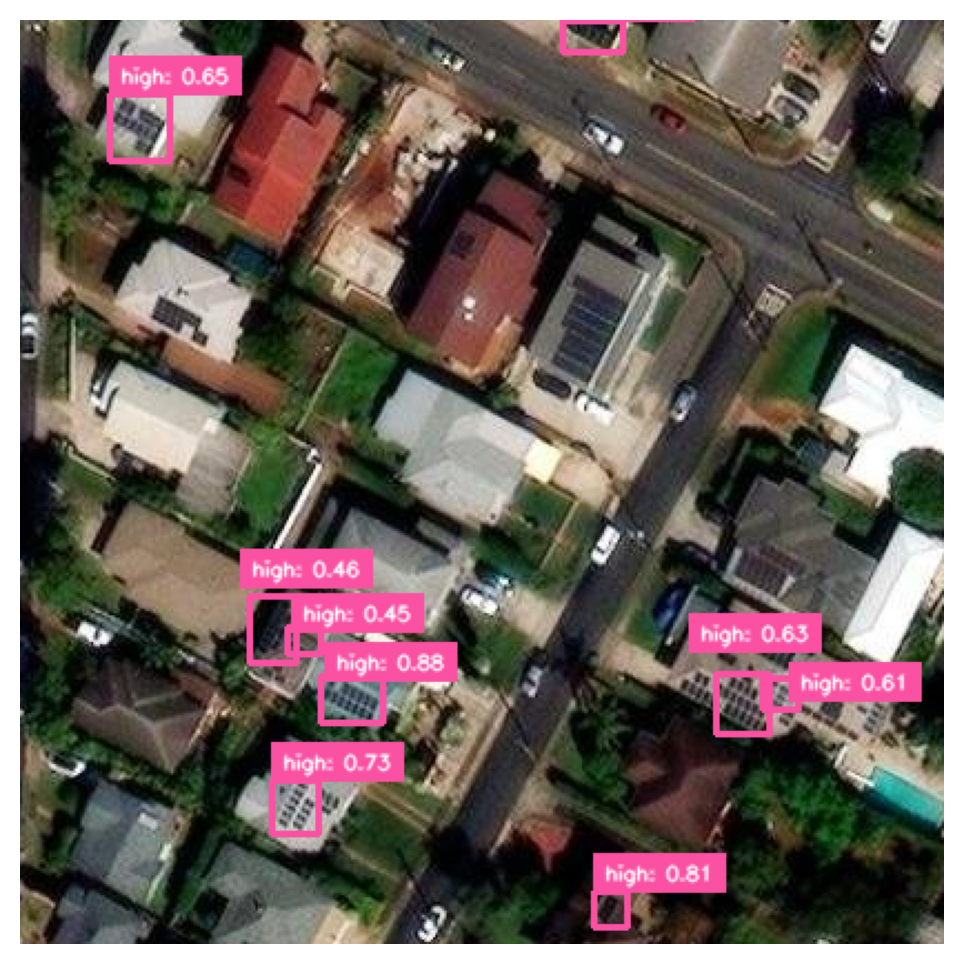

In [23]:
test_img = "/kaggle/input/satellite-iitgn/satellite121.tif"
give_image(test_img, model)


image 1/1 /kaggle/input/satellite-iitgn/satellite122.tif: 640x640 25 highs, 36.9ms
Speed: 2.4ms preprocess, 36.9ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (2, 158), (44, 180), 0.8508636)
1 :  (0, (5, 404), (29, 416), 0.48672867)
2 :  (0, (20, 46), (40, 62), 0.63159984)
3 :  (0, (22, 100), (44, 119), 0.5312379)
4 :  (0, (44, 50), (55, 66), 0.55692136)
5 :  (0, (50, 382), (78, 414), 0.68954265)
6 :  (0, (64, 9), (102, 29), 0.6190773)
7 :  (0, (74, 10), (102, 29), 0.5660406)
8 :  (0, (109, 14), (144, 35), 0.90509677)
9 :  (0, (121, 201), (164, 220), 0.8615894)
10 :  (0, (168, 32), (192, 46), 0.7666579)
11 :  (0, (169, 47), (181, 58), 0.49264297)
12 :  (0, (212, 379), (224, 384), 0.35831884)
13 :  (0, (220, 155), (251, 176), 0.850907)
14 :  (0, (221, 330), (235, 361), 0.84106284)
15 :  (0, (224, 163), (254, 180), 0.66724575)
16 :  (0, (229, 172), (259, 192), 0.82893676)
17 :  (0, (232, 186), (254, 201), 0.3054

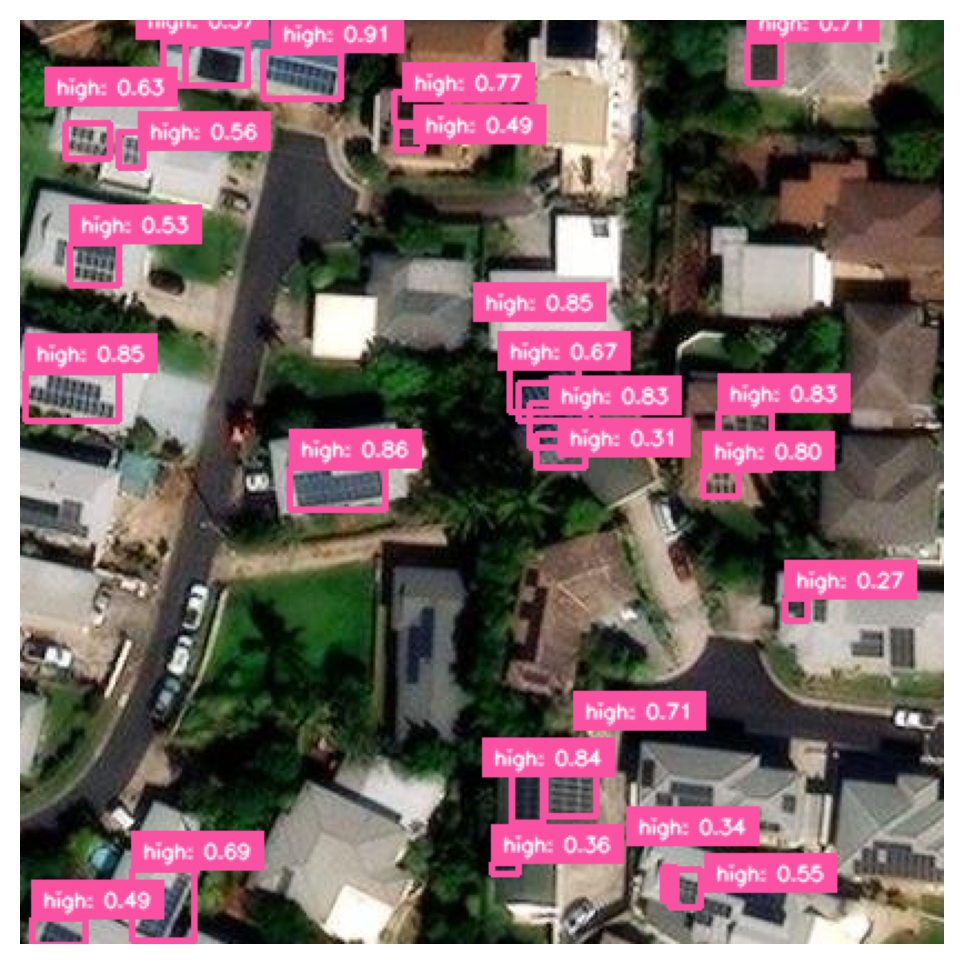

In [24]:
test_img = "/kaggle/input/satellite-iitgn/satellite122.tif"
give_image(test_img, model)


image 1/1 /kaggle/input/satellite-iitgn/satellite123.tif: 640x640 13 highs, 2 lows, 36.9ms
Speed: 2.3ms preprocess, 36.9ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

=================Prediction=================
0 :  (0, (42, 400), (71, 416), 0.45259023)
1 :  (0, (124, 251), (142, 271), 0.44781804)
2 :  (0, (145, 29), (170, 55), 0.85732025)
3 :  (0, (153, 184), (190, 212), 0.65863043)
4 :  (0, (166, 43), (191, 75), 0.74180627)
5 :  (0, (188, 251), (202, 266), 0.3252571)
6 :  (0, (257, 314), (275, 333), 0.3642158)
7 :  (0, (262, 140), (295, 185), 0.65746665)
8 :  (0, (277, 320), (299, 341), 0.851315)
9 :  (0, (278, 175), (299, 195), 0.8949093)
10 :  (0, (286, 149), (312, 177), 0.8909152)
11 :  (0, (306, 185), (330, 213), 0.81172514)
12 :  (0, (339, 162), (365, 192), 0.8276817)
13 :  (2, (306, 184), (330, 213), 0.3032376)
14 :  (2, (340, 162), (364, 192), 0.51279026)


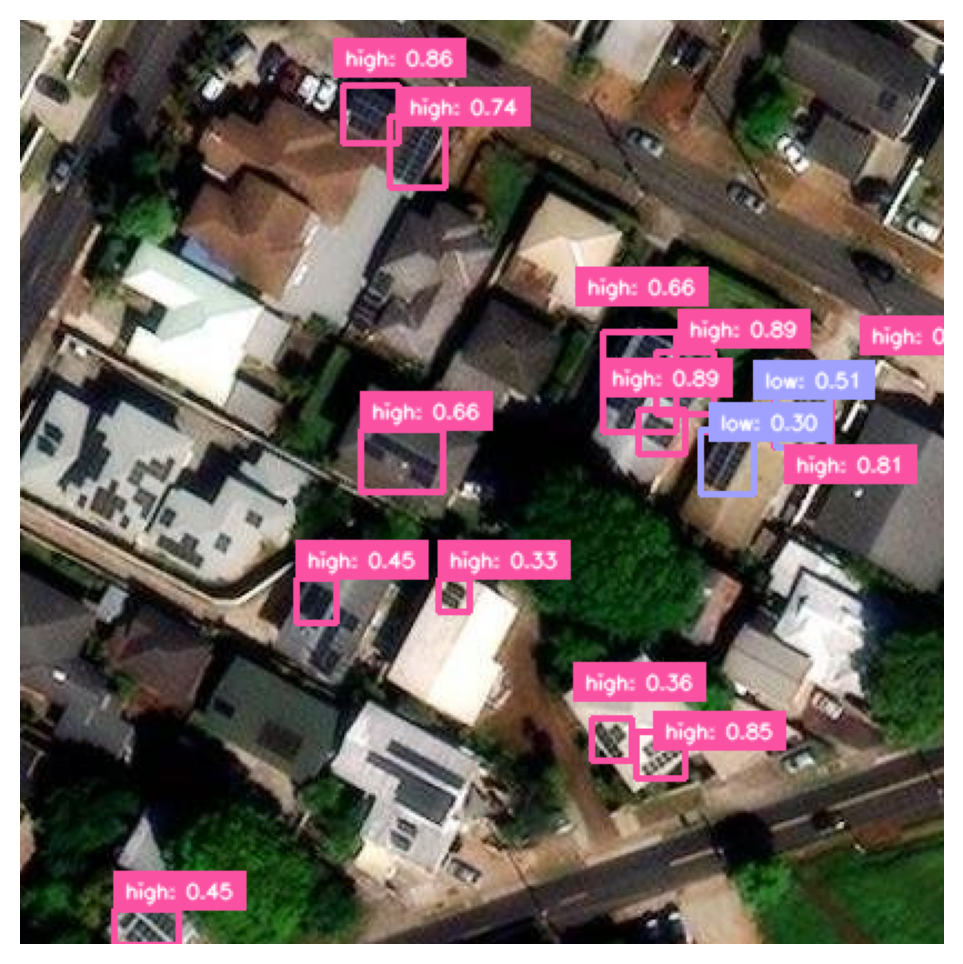

In [25]:
test_img = "/kaggle/input/satellite-iitgn/satellite123.tif"
give_image(test_img, model)